## Laboratorium 7


## Detekcja obiektów za pomocą Faster-RCNN

### Wprowadzenie

Celem tej listy jest praktyczne zapoznanie się z działaniem dwuetapowych modeli do detekcji obiektów na przykładzie Faster R-CNN. Skorzystamy z gotowej implementacji modelu z pakietu [`torchvision`](https://github.com/pytorch/vision/blob/main/torchvision/models/detection/faster_rcnn.py). Jeżeli masz inny ulubiony model działający na podobnej zasadzie, możesz z niego skorzystać zamiast podanego. Podobnie implementacja - jeśli masz swoją ulubioną bibliotekę np. Detectron2, MMDetection, możesz z niej skorzystać.

W zadaniu wykorzystany zostanie zbiór danych [_Chess Pieces Dataset_](https://public.roboflow.com/object-detection/chess-full) (autorstwa Roboflow, domena publiczna), ZIP z obrazami i anotacjami powinien być dołączony do instrukcji.

Podczas realizacji tej listy większy nacisk położony zostanie na inferencję z użyciem Faster R-CNN niż na uczenie (które przeprowadzisz raz\*). Kluczowe komponenty w tej architekturze (RPN i RoIHeads) można konfigurować bez ponownego uczenia, dlatego badania skupią się na ich strojeniu. Aby zrozumieć działanie modelu, konieczne będzie spojrzenie w jego głąb, włącznie z częściowym wykonaniem. W tym celu warto mieć na podorędziu kod źródłowy, w szczególności implementacje następujących klas (uwaga - linki do najnowszej implementacji; upewnij się więc, że czytasz kod używanej przez siebie wersji biblioteki):
* `FasterRCNN`: https://github.com/pytorch/vision/blob/main/torchvision/models/detection/faster_rcnn.py
* `GeneralizedRCNN`: https://github.com/pytorch/vision/blob/main/torchvision/models/detection/generalized_rcnn.py
* `RegionProposalNetwork`: https://github.com/pytorch/vision/blob/main/torchvision/models/detection/rpn.py
* `RoIHeads`: https://github.com/pytorch/vision/blob/main/torchvision/models/detection/roi_heads.py

Dogłębne zrozumienie procedury uczenia modelu nie będzie wymagane, niemniej należy mieć ogólną świadomość jak ten proces przebiega i jakie funkcje kosztu są wykorzystywane. Użyjemy gotowej implementacji z submodułu [`references.detection`](https://github.com/pytorch/vision/blob/main/references/detection/train.py) w nieco uproszczonej wersji. Ponieważ ten moduł **nie** jest domyślnie instalowaną częścią pakietu `torchvision`, do instrukcji dołączono jego kod w nieznacznie zmodyfikowanej wersji (`references_detection.zip`).
Jeśli ciekawią Cię szczegóły procesu uczenia, zachęcam do lektury [artykułu](https://arxiv.org/abs/1506.01497) i analizy kodu implementacji.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os

# Change the current working directory
current_dir = "/content/drive/MyDrive/images7"  # Specify your desired directory
os.chdir(current_dir)

# Verify the change
print(os.getcwd())

/content/drive/MyDrive/images7


In [ ]:
# prompt: unzip /content/drive/MyDrive/images7/dane/Chess Pieces.v23-raw.coco.zip and /content/drive/MyDrive/images7/dane/wild.zip

# !unzip /content/drive/MyDrive/images7/dane/Chess\ Pieces.v23-raw.coco.zip -d /content/drive/MyDrive/images7/dane/
# !unzip /content/drive/MyDrive/images7/dane/wild.zip -d /content/drive/MyDrive/images7/dane/

Archive:  /content/drive/MyDrive/images7/dane/Chess Pieces.v23-raw.coco.zip
 extracting: /content/drive/MyDrive/images7/dane/README.dataset.txt  
 extracting: /content/drive/MyDrive/images7/dane/README.roboflow.txt  
   creating: /content/drive/MyDrive/images7/dane/test/
 extracting: /content/drive/MyDrive/images7/dane/test/0b47311f426ff926578c9d738d683e76_jpg.rf.0b55f43ac16aa65c889558d8ea757072.jpg  
 extracting: /content/drive/MyDrive/images7/dane/test/1c0060ef868bdc326ce5e6389cb6732f_jpg.rf.9ce88078ea356949f4ab7ad9cfdfc62d.jpg  
 extracting: /content/drive/MyDrive/images7/dane/test/2f6fb003bb89cd401322a535acb42f65_jpg.rf.91ad9df05bd1f86bab67c8368ae5e4ad.jpg  
 extracting: /content/drive/MyDrive/images7/dane/test/410993714e325a1de3e394ffe860df3a_jpg.rf.519bf0fdbd5e38cd44cae1cfebc98536.jpg  
 extracting: /content/drive/MyDrive/images7/dane/test/4e3117459d759798537eb52cf5bf534d_jpg.rf.5b99421bf416463a8c75cfd07f8a68d1.jpg  
 extracting: /content/drive/MyDrive/images7/dane/test/5a35ba2ec

In [ ]:
%pip install torch torchvision

In [ ]:
# %pip install torchvision>=0.13 # jeśli nie posiadasz pakietu torchvision

In [ ]:
!pip install pycocotools

### Zadanie 0: Uczenie

Krokiem "zerowym" będzie przygotowanie wstępnie nauczonego modelu i douczenie go na docelowym zbiorze.
Podany zestaw hiperparametrów powinien dawać przyzwoite (niekoniecznie idealne) wyniki - jeśli chcesz, śmiało dobierz swoje własne; nie spędzaj na tym jednak zbyt wiele czasu.

Twoim zadaniem jest nie tylko przeklikanie poniższych komórek, ale przynajmniej ogólne zrozumienie procesu uczenia (przejrzyj implementację `train_one_epoch`) i struktury modelu.

In [ ]:
import os
import time
import datetime

import torch
import torch.utils.data
import torchvision
import torchvision.models.detection as M
from torchvision.io.image import read_image
from torchvision.utils import draw_bounding_boxes
from torchvision.transforms.functional import to_pil_image

from detection import coco_utils, presets, utils, transforms
from detection.engine import train_one_epoch, evaluate

In [ ]:
def fake_segmentation(image, target):
    for obj in target["annotations"]:
        x, y, w, h = obj["bbox"]
        segm = [x, y, x + w, y, x + w, y + h, x, y + h]
        obj["segmentation"] = [segm]
    return image, target

In [ ]:
def get_dataset(img_root: str, file_name: str, train: bool = True):
    """Reimplementacja analogicznej funkcji z pakietu references, rozwiązująca drobną niekompatybilność w zbiorze CPD"""

    tfs = transforms.Compose(
        [
            fake_segmentation,
            coco_utils.ConvertCocoPolysToMask(),
            (
                presets.DetectionPresetTrain(data_augmentation="hflip")
                if train
                else presets.DetectionPresetEval()
            ),
            # jeśli chcesz dodać swoje własne augmentacje, możesz zrobić to tutaj
        ]
    )
    ds = coco_utils.CocoDetection(img_root, file_name, transforms=tfs)
    return ds

In [ ]:
# Konfiguracja hiperparametrów
LR = 0.001 # powinno być dobrze dla 1 GPU
WDECAY = 0.0001
EPOCHS = 100
VAL_FREQ = 5 # walidacja i checkpointowanie co N epok
BATCH_SIZE = 2 # dobierz pod możliwości sprzętowe
NUM_WORKERS = 2 # j/w
NUM_CLASSES = 14
DEVICE = 'cuda:0'
DATASET_ROOT = 'dane/'
OUTPUT_DIR = 'outputs/'

In [ ]:
# Zaczytanie datasetów
chess_train = get_dataset(os.path.join(DATASET_ROOT, 'train'), os.path.join(DATASET_ROOT, 'train/_annotations.coco.json'))
chess_val = get_dataset(os.path.join(DATASET_ROOT, 'valid'), os.path.join(DATASET_ROOT, 'valid/_annotations.coco.json'))

loading annotations into memory...
Done (t=1.44s)
creating index...
index created!
loading annotations into memory...
Done (t=0.74s)
creating index...
index created!


In [ ]:
# samplery i loadery
train_sampler = torch.utils.data.RandomSampler(chess_train)
train_batch_sampler = torch.utils.data.BatchSampler(train_sampler, BATCH_SIZE, drop_last=True)
train_loader = torch.utils.data.DataLoader(
  chess_train, batch_sampler=train_batch_sampler, num_workers=NUM_WORKERS, collate_fn=utils.collate_fn
)

val_sampler = torch.utils.data.SequentialSampler(chess_val)
val_loader = torch.utils.data.DataLoader(
  chess_val, batch_size=1, sampler=val_sampler, num_workers=NUM_WORKERS, collate_fn=utils.collate_fn
)

In [ ]:
# Skonstruowanie modelu; tworzymy w wersji dla 91 klas aby zainicjować wagi wstępnie nauczone na COCO...
model = M.fasterrcnn_resnet50_fpn(weights=M.FasterRCNN_ResNet50_FPN_Weights.COCO_V1, num_classes=91).to(DEVICE)
# ...po czym zastępujemy predyktor mniejszym, dostosowanym do naszego zbioru:
model.roi_heads.box_predictor = M.faster_rcnn.FastRCNNPredictor(in_channels=1024, num_classes=NUM_CLASSES).to(DEVICE)

Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth
100%|██████████| 160M/160M [00:02<00:00, 71.1MB/s]


In [ ]:
model # zwróć uwagę na strukturę Box Predictora (dlaczego tyle out_features?)

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

#UCZENIE - POMIŃ JEŻELI JUŻ UCZYŁEŚ

In [ ]:
# Zanim przejdziemy do uczenia pełnego modelu, wykonamy krótkie wstępne uczenie losowo zainicjowanego predyktora:
# train_one_epoch(
#   model=model,
#   optimizer=torch.optim.AdamW(model.roi_heads.box_predictor.parameters(), lr=LR, weight_decay=WDECAY),
#   data_loader=train_loader,
#   device=DEVICE,
#   epoch=0, print_freq=20, scaler=None
# )

/content/drive/MyDrive/images7/detection/engine.py:32: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=scaler is not None):


Epoch: [0]  [  0/101]  eta: 0:08:38  lr: 0.000011  loss: 2.9182 (2.9182)  loss_classifier: 2.3190 (2.3190)  loss_box_reg: 0.4453 (0.4453)  loss_objectness: 0.1362 (0.1362)  loss_rpn_box_reg: 0.0177 (0.0177)  time: 5.1337  data: 1.1468  max mem: 2462
Epoch: [0]  [ 20/101]  eta: 0:01:10  lr: 0.000211  loss: 2.7928 (2.6022)  loss_classifier: 1.9771 (1.9308)  loss_box_reg: 0.4306 (0.3890)  loss_objectness: 0.2390 (0.2618)  loss_rpn_box_reg: 0.0171 (0.0205)  time: 0.6536  data: 0.0721  max mem: 2608
Epoch: [0]  [ 40/101]  eta: 0:00:49  lr: 0.000411  loss: 1.5496 (2.1776)  loss_classifier: 0.7342 (1.3906)  loss_box_reg: 0.4108 (0.4070)  loss_objectness: 0.4114 (0.3536)  loss_rpn_box_reg: 0.0307 (0.0264)  time: 0.7649  data: 0.1465  max mem: 2680
Epoch: [0]  [ 60/101]  eta: 0:00:31  lr: 0.000610  loss: 0.9601 (1.7996)  loss_classifier: 0.4738 (1.0805)  loss_box_reg: 0.3002 (0.3615)  loss_objectness: 0.1658 (0.3329)  loss_rpn_box_reg: 0.0116 (0.0246)  time: 0.7043  data: 0.0969  max mem: 2680


In [ ]:
# Uczenie pełnego modelu
# optimizer = torch.optim.AdamW(
#   [p for p in model.parameters() if p.requires_grad],
#   lr=LR,
#   weight_decay=WDECAY
# )
# lr_scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=[10], gamma=0.1) # dobierz wartości jeśli trzeba


In [ ]:

# start_time = time.time()
# for epoch in range(EPOCHS):
#     train_one_epoch(model, optimizer, train_loader, DEVICE, epoch, 20, None)
#     lr_scheduler.step()

#     # eval and checkpoint every VAL_FREQ epochs
#     if (epoch+1) % VAL_FREQ == 0:
#       checkpoint = {
#           "model": model.state_dict(),
#           "optimizer": optimizer.state_dict(),
#           "lr_scheduler": lr_scheduler.state_dict(),
#           "epoch": epoch,
#       }
#       utils.save_on_master(checkpoint, os.path.join(OUTPUT_DIR, f"model_{epoch}.pth"))
#       utils.save_on_master(checkpoint, os.path.join(OUTPUT_DIR, "checkpoint.pth"))
#       evaluate(model, val_loader, device=DEVICE)

# total_time = time.time() - start_time
# total_time_str = str(datetime.timedelta(seconds=int(total_time)))
# print(f"Training time {total_time_str}")

Epoch: [0]  [  0/101]  eta: 0:03:38  lr: 0.000011  loss: 0.9480 (0.9480)  loss_classifier: 0.3103 (0.3103)  loss_box_reg: 0.2140 (0.2140)  loss_objectness: 0.3944 (0.3944)  loss_rpn_box_reg: 0.0293 (0.0293)  time: 2.1613  data: 1.3051  max mem: 2680
Epoch: [0]  [ 20/101]  eta: 0:01:05  lr: 0.000211  loss: 0.5591 (0.5735)  loss_classifier: 0.3297 (0.3000)  loss_box_reg: 0.2027 (0.2022)  loss_objectness: 0.0081 (0.0555)  loss_rpn_box_reg: 0.0098 (0.0159)  time: 0.7452  data: 0.1330  max mem: 2815
Epoch: [0]  [ 40/101]  eta: 0:00:48  lr: 0.000411  loss: 0.5048 (0.5879)  loss_classifier: 0.2601 (0.2994)  loss_box_reg: 0.2793 (0.2388)  loss_objectness: 0.0019 (0.0303)  loss_rpn_box_reg: 0.0137 (0.0193)  time: 0.7822  data: 0.1262  max mem: 2895
Epoch: [0]  [ 60/101]  eta: 0:00:33  lr: 0.000610  loss: 0.4325 (0.5527)  loss_classifier: 0.1816 (0.2686)  loss_box_reg: 0.2413 (0.2431)  loss_objectness: 0.0011 (0.0214)  loss_rpn_box_reg: 0.0160 (0.0196)  time: 0.8346  data: 0.1574  max mem: 2899


# Wczytanie przyzwoicie wytrenowanego modelu


In [ ]:
optimizer = torch.optim.AdamW(
  [p for p in model.parameters() if p.requires_grad],
  lr=LR,
  weight_decay=WDECAY
)
lr_scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=[10], gamma=0.1)


checkpoint = torch.load(os.path.join(OUTPUT_DIR, "checkpoint.pth"), map_location=DEVICE)
model.load_state_dict(checkpoint["model"])
optimizer.load_state_dict(checkpoint["optimizer"])
lr_scheduler.load_state_dict(checkpoint["lr_scheduler"])
start_epoch = checkpoint["epoch"] + 1

print(f"Checkpoint loaded, starting from epoch {start_epoch}")

<ipython-input-13-64b6886885cd>:9: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(os.path.join(OUTPUT_DIR, "checkpoint.pth"), map_location=DEVICE)


Checkpoint loaded, starting from epoch 100


In [ ]:
DEVICE = 'cpu'
model = model.to(DEVICE)
next(model.parameters()).device

device(type='cpu')

In [ ]:
import matplotlib.pyplot as plt

In [ ]:
# Inferencja na zadanym obrazie
preprocess = M.FasterRCNN_ResNet50_FPN_Weights.COCO_V1.transforms() # to wystarczy pobrać raz
img = read_image(os.path.join(DATASET_ROOT, 'test/IMG_0159_JPG.rf.1cf4f243b5072d63e492711720df35f7.jpg'))
batch = [preprocess(img).to(DEVICE)]

# Set the model to evaluation mode
model.eval()

# Perform inference
with torch.no_grad():
  prediction = model(batch)[0]

# Rysowanie predykcji - wygodny gotowiec
box = draw_bounding_boxes(
  img,
  boxes=prediction['boxes'],
  labels=[chess_train.coco.cats[i.item()]['name'] for i in prediction['labels']],
  colors='red',
  width=4,
)



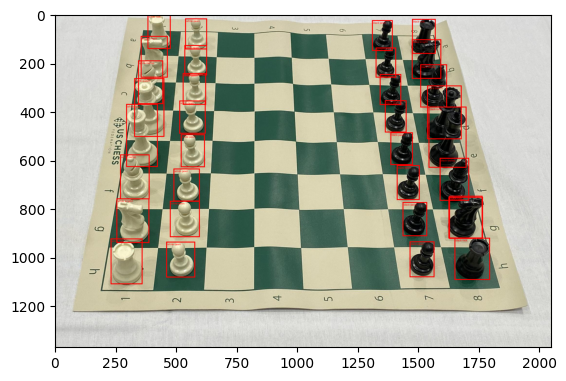

In [ ]:

plt.imshow(to_pil_image(box.detach()))
# to_pil_image(box.detach()).show()

---
### Zadanie 1

Zbadaj wpływ parametrów inferencji **głowic `RoIHeads`**, progu prawdopodobieństwa (`score_thresh`) i progu NMS (`nms_thresh`), na działanie modelu. Wykorzystaj funkcję `evaluate` aby zmierzyć zmianę jakości predykcji, ale przebadaj też efekty wizualnie, wyświetlając predykcje dla kilku obrazów ze zbioru walidacyjnego i kilku spoza zbioru (folder `wild`). _W finalnej wersji pozostaw tylko wybrane interesujące przykłady._

Oba parametry dotyczą filtrowania propozycji regionów w drugim etapie detekcji.

## `score_thresh`
Ten parametr określa minimalny próg pewności (confidence score), jaki musi osiągnąć dany region, aby został uznany za detekcję obiektu.


 # remove low scoring boxes ( z dokumentacj )
            inds = torch.where(scores > self.score_thresh)[0]
            boxes, scores, labels = boxes[inds], scores[inds], labels[inds]

In [ ]:
model.roi_heads

RoIHeads(
  (box_roi_pool): MultiScaleRoIAlign(featmap_names=['0', '1', '2', '3'], output_size=(7, 7), sampling_ratio=2)
  (box_head): TwoMLPHead(
    (fc6): Linear(in_features=12544, out_features=1024, bias=True)
    (fc7): Linear(in_features=1024, out_features=1024, bias=True)
  )
  (box_predictor): FastRCNNPredictor(
    (cls_score): Linear(in_features=1024, out_features=14, bias=True)
    (bbox_pred): Linear(in_features=1024, out_features=56, bias=True)
  )
)

In [ ]:
print(f'Score thresh: {model.roi_heads.score_thresh}')
print(f'NMS thresh: {model.roi_heads.nms_thresh}')

Score thresh: 0.05
NMS thresh: 0.5


In [ ]:
evaluate(model, val_loader, device=DEVICE)

Test:  [ 0/58]  eta: 0:03:10  model_time: 0.1562 (0.1562)  evaluator_time: 0.0044 (0.0044)  time: 3.2874  data: 3.1176  max mem: 1136
Test:  [57/58]  eta: 0:00:00  model_time: 0.1063 (0.1083)  evaluator_time: 0.0016 (0.0030)  time: 0.5399  data: 0.4140  max mem: 1136
Test: Total time: 0:00:34 (0.5885 s / it)
Averaged stats: model_time: 0.1063 (0.1083)  evaluator_time: 0.0016 (0.0030)
Accumulating evaluation results...
DONE (t=0.05s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.186
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.254
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.224
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.186
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDe

In [ ]:
def visualize_predictions(model, dataset, device, score_thresh=0.5, nms_thresh=0.5, num_images=5):
    model.roi_heads.score_thresh = score_thresh
    model.roi_heads.nms_thresh = nms_thresh
    model.eval()

    fig, axs = plt.subplots(1, num_images, figsize=(20, 5))
    for i in range(num_images):
        img, _ = dataset[i]
        img = img.to(device)
        with torch.no_grad():
            prediction = model([img])[0]

        box = draw_bounding_boxes(
            img.cpu(),
            boxes=prediction['boxes'],
            labels=[dataset.coco.cats[i.item()]['name'] for i in prediction['labels']],
            colors='red',
            width=4,
        )
        axs[i].imshow(to_pil_image(box.detach()))
        axs[i].axis('off')
    plt.show()

In [ ]:
file_names = [
    'valid/3baf85c957b9d28a16c0b65cb2ef0d29_jpg.rf.ee68e051c8a61b8784b87686d828cf59.jpg',
    'valid/495019998442ddf85b59e387d4916cd3_jpg.rf.9d9d8ec43f8494e2bfe6603811f7b3de.jpg',
    'valid/55be99616328f83dcbfe8c18e1387c0e_jpg.rf.704f9d21a024a31afa058f00ea6d6ca9.jpg',
    'valid/bb0de9761d16eee258ae09d8de32002c_jpg.rf.c11059695bd371034e76c84073775603.jpg',
    'valid/7e97f49e613a59a70b833e4c0b2c1c04_jpg.rf.e3d8cc08e136002cec4bf8350be37c47.jpg',
    'chesscom_fide.jpeg',
    'chesscom_uscf.jpeg',
    'shop.jpg'
]

img_paths = [ DATASET_ROOT + name for name in file_names]


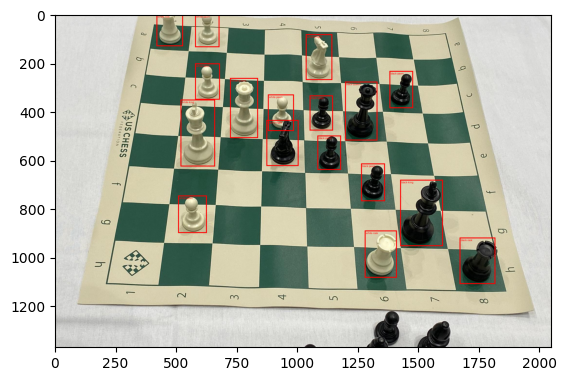

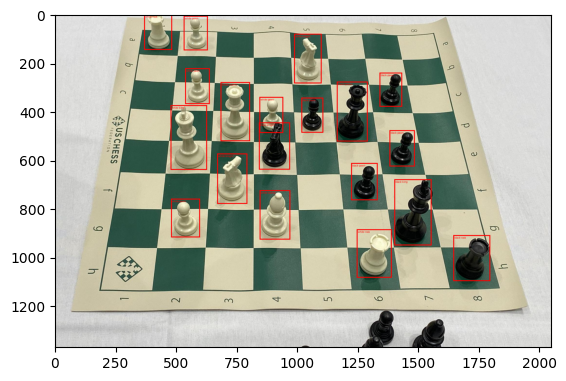

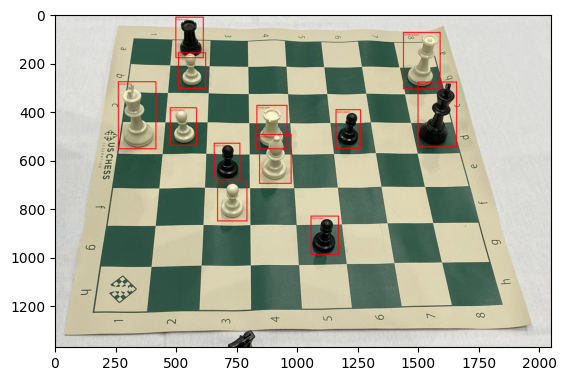

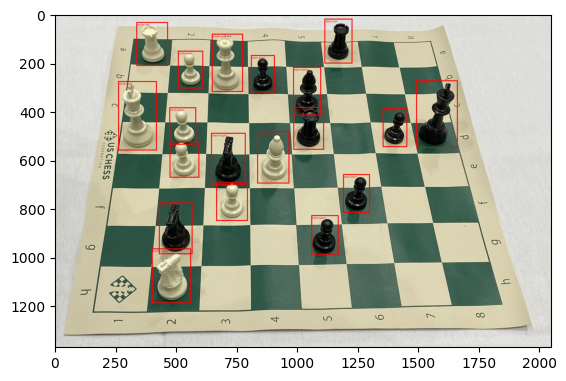

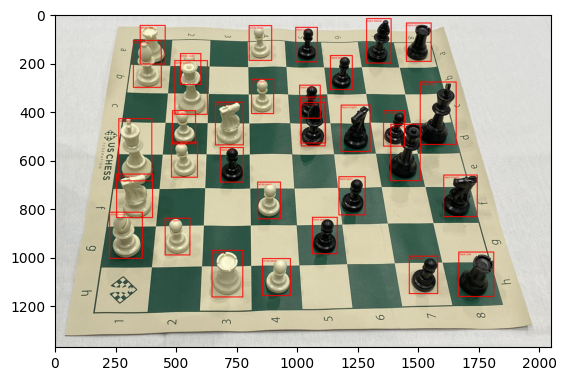

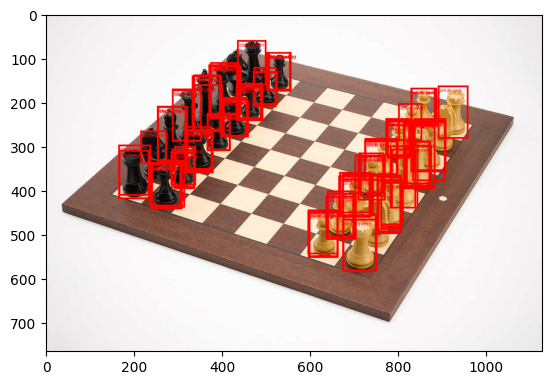

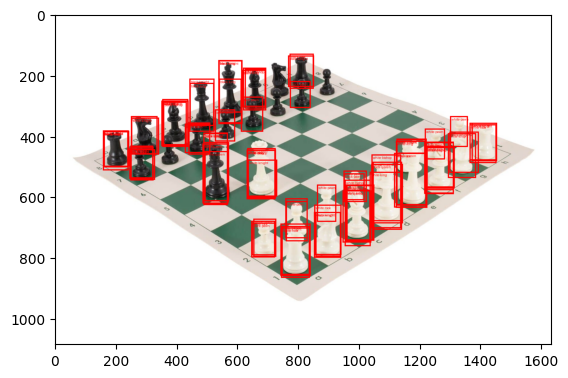

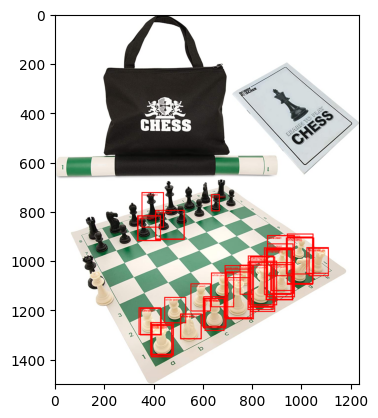

In [ ]:
# Make predictions on the  images
for img_path in img_paths:
    img = read_image(img_path)
    batch = [preprocess(img).to(DEVICE)]
    model.eval()

    with torch.no_grad():
        prediction = model(batch)[0]

        box = draw_bounding_boxes(
            img,
            boxes=prediction['boxes'],
            labels=[chess_val.coco.cats[i.item()]['name'] for i in prediction['labels']],
            colors='red',
            width=4,
        )
        plt.imshow(to_pil_image(box.detach()))
        plt.show()

In [ ]:
def visualize_predictions(model, device, images_path_names, dataset):
    model.eval()

    fig, axs = plt.subplots(4, 2, figsize=(15, 20))
    for i, img_path in enumerate(images_path_names):
        img = read_image(img_path)
        batch = [preprocess(img).to(DEVICE)]
        img = img.to(device)
        with torch.no_grad():
            prediction = model(batch)[0]

        number_of_boxes = len(prediction['boxes'])
        #make a dict of the labels and the number of boxes
        labels = {}
        for label in prediction['labels']:
            label_name = dataset.coco.cats[label.item()]['name']
            if label_name in labels:
                labels[label_name] += 1
            else:
                labels[label_name] = 1
        # print(labels)
        box = draw_bounding_boxes(
            img.cpu(),
            boxes=prediction['boxes'],
            labels=[dataset.coco.cats[i.item()]['name'] for i in prediction['labels']],
            colors='red',
            width=4,
        )
        ax = axs[i % 4, i // 4]
        ax.imshow(to_pil_image(box.detach()))
        ax.axis('off')
        ax.set_title(f'Image {i+1}\nNumber of boxes: {number_of_boxes}')
    plt.show()

Evaluating with score_thresh=1e-05 and nms_thresh=0.5
Test:  [ 0/58]  eta: 0:00:50  model_time: 0.1788 (0.1788)  evaluator_time: 0.0274 (0.0274)  time: 0.8696  data: 0.6415  max mem: 1173
Test:  [57/58]  eta: 0:00:00  model_time: 0.1146 (0.1244)  evaluator_time: 0.0043 (0.0121)  time: 0.1798  data: 0.0339  max mem: 1173
Test: Total time: 0:00:13 (0.2286 s / it)
Averaged stats: model_time: 0.1146 (0.1244)  evaluator_time: 0.0043 (0.0121)
Accumulating evaluation results...
DONE (t=0.08s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.204
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.278
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.242
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.204
 Average 

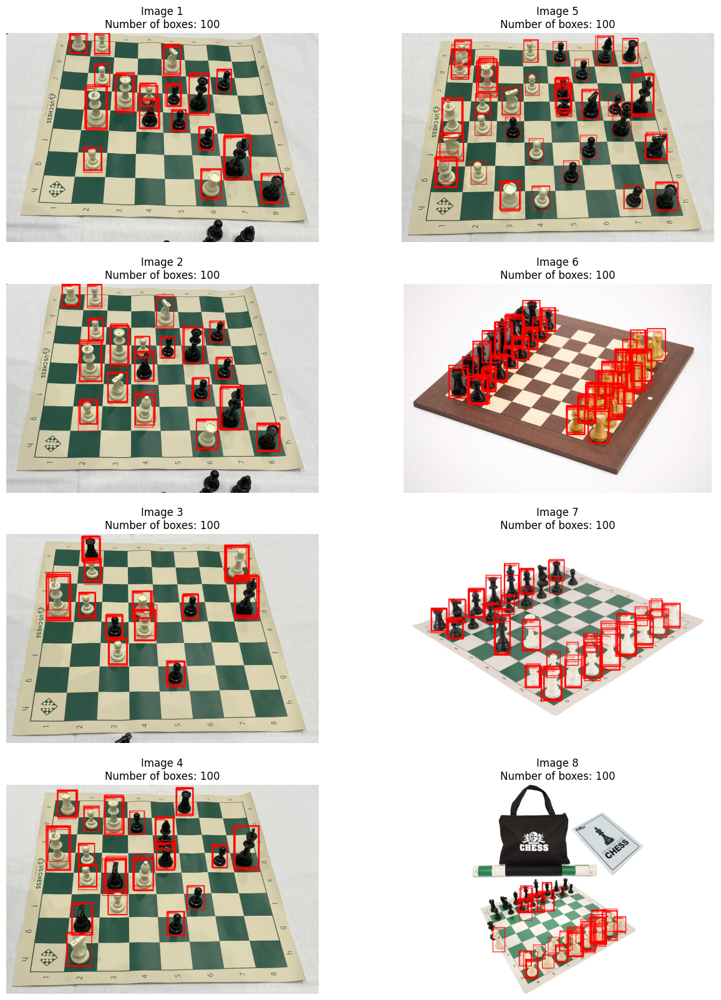

Evaluating with score_thresh=0.0001 and nms_thresh=0.5
Test:  [ 0/58]  eta: 0:01:06  model_time: 0.1827 (0.1827)  evaluator_time: 0.0210 (0.0210)  time: 1.1514  data: 0.9153  max mem: 1173
Test:  [57/58]  eta: 0:00:00  model_time: 0.1236 (0.1237)  evaluator_time: 0.0116 (0.0101)  time: 0.2266  data: 0.0644  max mem: 1173
Test: Total time: 0:00:13 (0.2272 s / it)
Averaged stats: model_time: 0.1236 (0.1237)  evaluator_time: 0.0116 (0.0101)
Accumulating evaluation results...
DONE (t=0.13s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.263
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.354
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.263
 Average

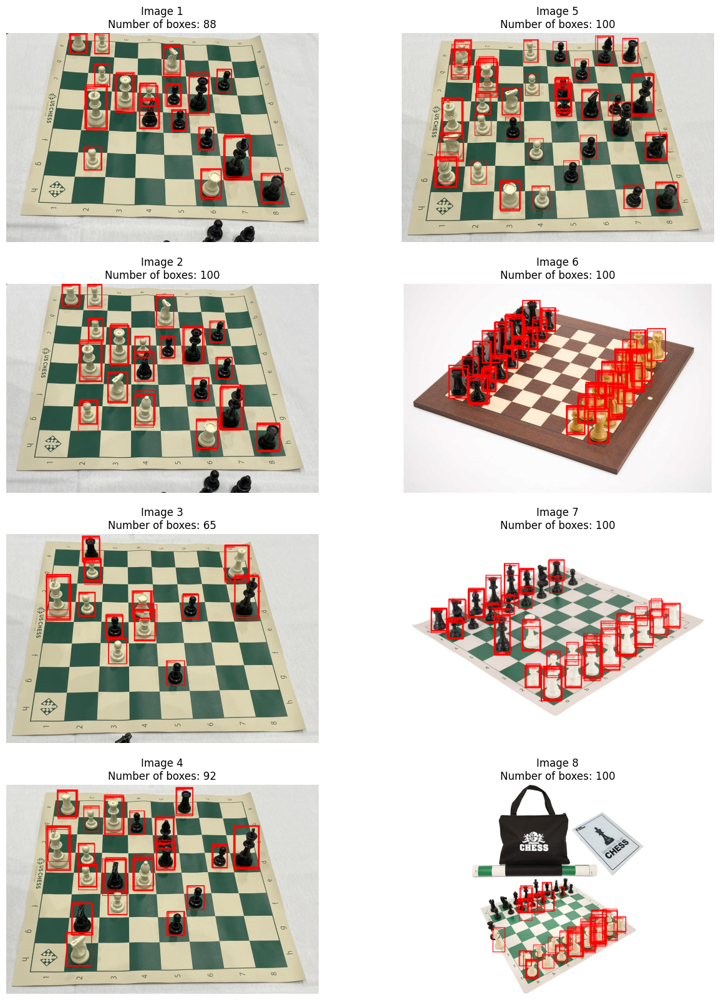

Evaluating with score_thresh=0.001 and nms_thresh=0.5
Test:  [ 0/58]  eta: 0:01:03  model_time: 0.1770 (0.1770)  evaluator_time: 0.0115 (0.0115)  time: 1.0880  data: 0.8882  max mem: 1173
Test:  [57/58]  eta: 0:00:00  model_time: 0.1135 (0.1227)  evaluator_time: 0.0037 (0.0084)  time: 0.2374  data: 0.0808  max mem: 1173
Test: Total time: 0:00:14 (0.2493 s / it)
Averaged stats: model_time: 0.1135 (0.1227)  evaluator_time: 0.0037 (0.0084)
Accumulating evaluation results...
DONE (t=0.07s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.218
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.307
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.274
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.218
 Average 

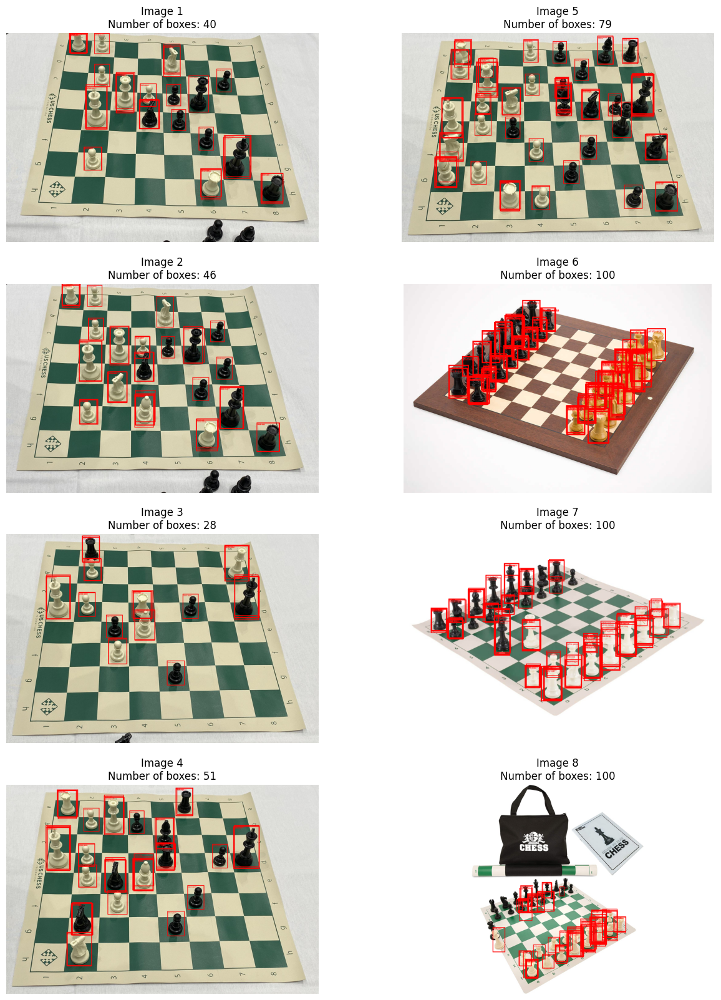

Evaluating with score_thresh=0.1 and nms_thresh=0.5
Test:  [ 0/58]  eta: 0:01:01  model_time: 0.1674 (0.1674)  evaluator_time: 0.0078 (0.0078)  time: 1.0673  data: 0.8760  max mem: 1173
Test:  [57/58]  eta: 0:00:00  model_time: 0.1125 (0.1233)  evaluator_time: 0.0017 (0.0057)  time: 0.1874  data: 0.0422  max mem: 1173
Test: Total time: 0:00:14 (0.2467 s / it)
Averaged stats: model_time: 0.1125 (0.1233)  evaluator_time: 0.0017 (0.0057)
Accumulating evaluation results...
DONE (t=0.05s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.468
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.611
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.580
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.468
 Average Re

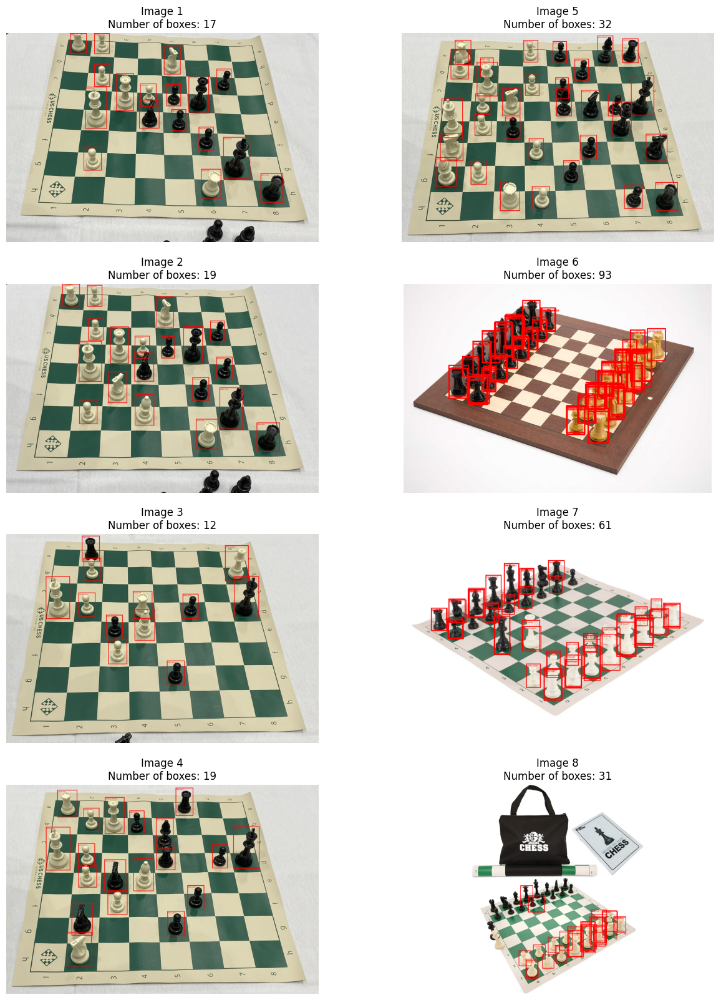

In [ ]:
score_thresholds = [0.00001, 0.0001, 0.001, 0.1]
nms_thresh = 0.5

for score_thresh in score_thresholds:
    print(f"Evaluating with score_thresh={score_thresh} and nms_thresh={nms_thresh}")
    model.roi_heads.score_thresh = score_thresh
    model.roi_heads.nms_thresh = nms_thresh
    evaluate(model, val_loader, device=DEVICE)
    visualize_predictions(model, DEVICE, img_paths, chess_val)

## `nms_thresh`
Ten parametr kontroluje proces eliminowania nakładających się detekcji (bounding boxów), aby uniknąć wielokrotnych wykryć tego samego obiektu.
Próg decyduje, jak dużo nakładających się detekcji zostanie zachowanych.



*   Po uzyskaniu listy detekcji, NMS porównuje nakładające się bounding boxy (według wskaźnika IoU - Intersection over Union).
*   Wybierany jest bounding box z najwyższym score, a inne nakładające się boxy są odrzucane, jeśli ich IoU przekracza próg NMS.



Evaluating with score_thresh=0.05 and nms_thresh=0.9
Test:  [ 0/58]  eta: 0:01:18  model_time: 0.1914 (0.1914)  evaluator_time: 0.0198 (0.0198)  time: 1.3454  data: 1.1182  max mem: 1173
Test:  [57/58]  eta: 0:00:00  model_time: 0.1159 (0.1246)  evaluator_time: 0.0021 (0.0057)  time: 0.2271  data: 0.0706  max mem: 1173
Test: Total time: 0:00:14 (0.2502 s / it)
Averaged stats: model_time: 0.1159 (0.1246)  evaluator_time: 0.0021 (0.0057)
Accumulating evaluation results...
DONE (t=0.09s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.157
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.217
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.189
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.157
 Average R

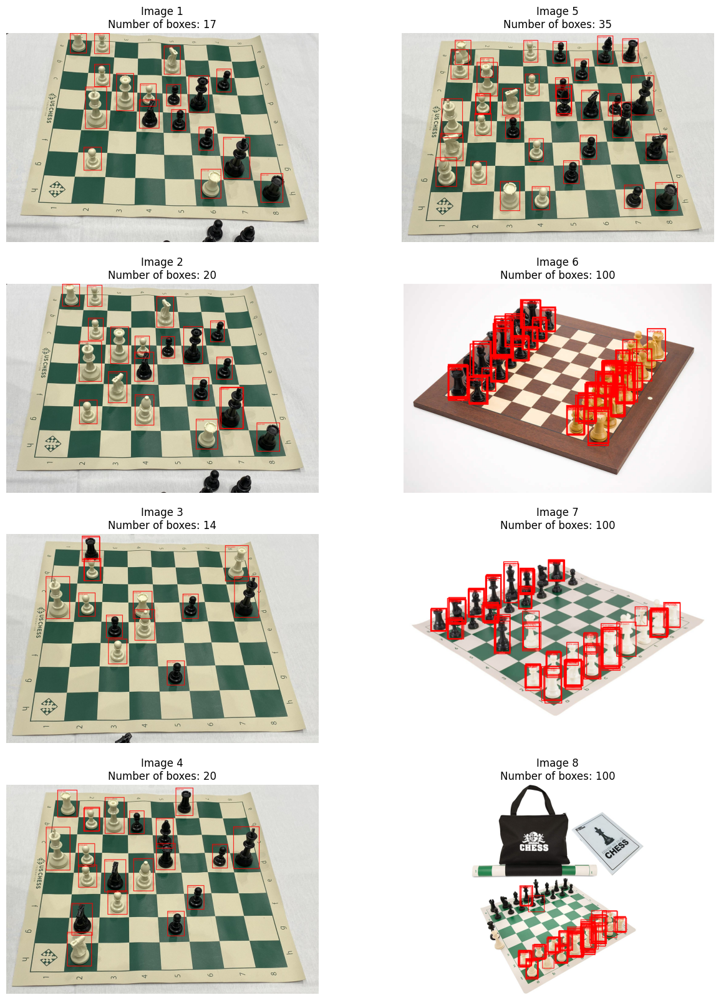

Evaluating with score_thresh=0.05 and nms_thresh=0.95
Test:  [ 0/58]  eta: 0:00:57  model_time: 0.1709 (0.1709)  evaluator_time: 0.0124 (0.0124)  time: 0.9970  data: 0.7995  max mem: 1173
Test:  [57/58]  eta: 0:00:00  model_time: 0.1256 (0.1253)  evaluator_time: 0.0024 (0.0075)  time: 0.2498  data: 0.0884  max mem: 1173
Test: Total time: 0:00:14 (0.2516 s / it)
Averaged stats: model_time: 0.1256 (0.1253)  evaluator_time: 0.0024 (0.0075)
Accumulating evaluation results...
DONE (t=0.06s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.220
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.294
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.269
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.220
 Average 

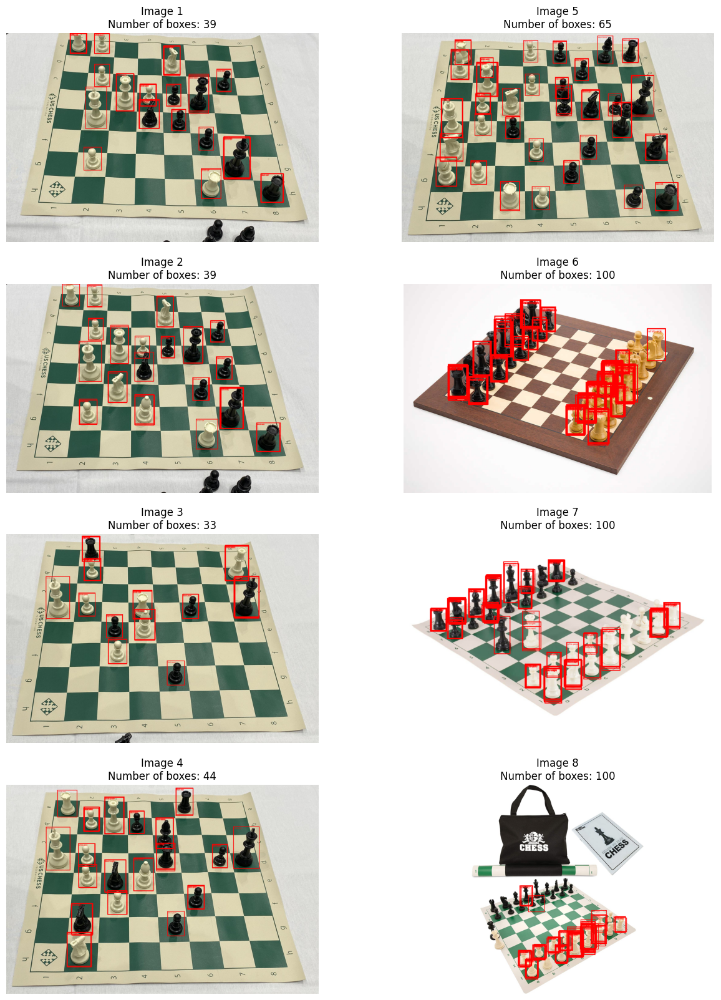

Evaluating with score_thresh=0.05 and nms_thresh=0.99
Test:  [ 0/58]  eta: 0:01:01  model_time: 0.1608 (0.1608)  evaluator_time: 0.0152 (0.0152)  time: 1.0540  data: 0.8532  max mem: 1173
Test:  [57/58]  eta: 0:00:00  model_time: 0.1146 (0.1238)  evaluator_time: 0.0067 (0.0133)  time: 0.1925  data: 0.0423  max mem: 1173
Test: Total time: 0:00:14 (0.2536 s / it)
Averaged stats: model_time: 0.1146 (0.1238)  evaluator_time: 0.0067 (0.0133)
Accumulating evaluation results...
DONE (t=0.06s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.166
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.212
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.199
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.166
 Average 

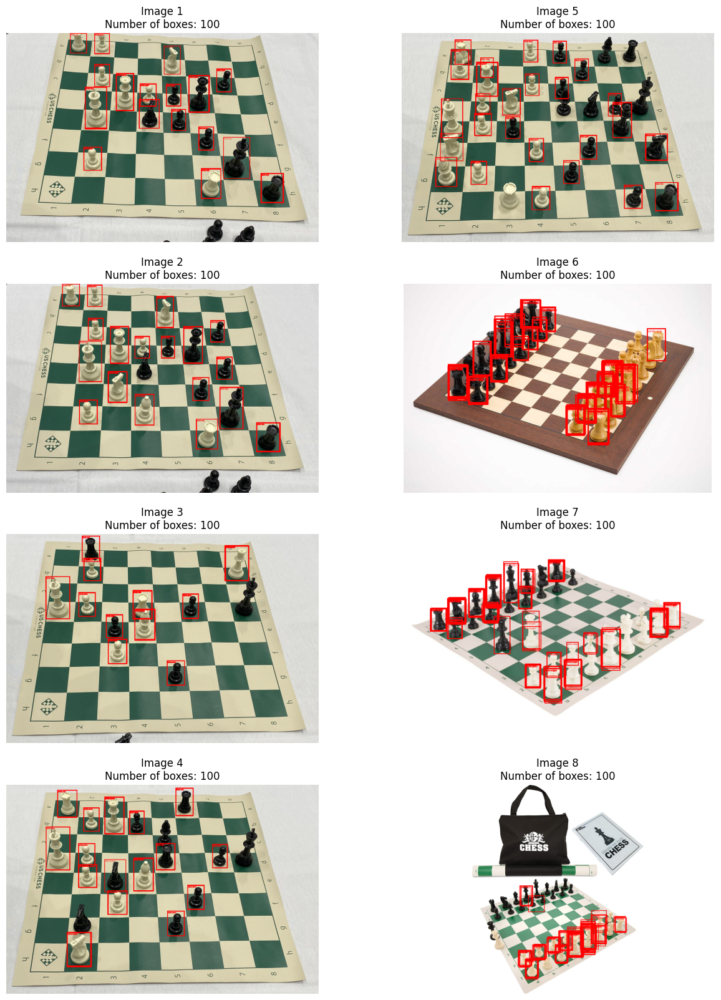

In [ ]:
score_thresh = 0.05
nms_thresholds = [0.9, 0.95, 0.99]

for nms_thresh in nms_thresholds:
    print(f"Evaluating with score_thresh={score_thresh} and nms_thresh={nms_thresh}")
    model.roi_heads.score_thresh = score_thresh
    model.roi_heads.nms_thresh = nms_thresh
    evaluate(model, val_loader, device=DEVICE)
    visualize_predictions(model, DEVICE, img_paths, chess_val)

* Zwiększenie progu: Więcej nakładających się regionów może być zaakceptowanych. Może prowadzić do duplikatów wykryć (np. kilka bounding boxów dla tego samego obiektu).
* Zmniejszenie: surowsze podejście, większa precyzja (mniej duplikatów). Potencjalne ryzyko usunięcia regionów reprezentujących różne części tego samego obiektu.

### Zadanie 2a

Zwizualizuj propozycje rejonów wygenerowane przez RPN i porównaj z ostateczną predykcją.

W tym celu konieczne będzie manualne wykonanie fragmentu metody `GeneralizedRCNN::forward` (patrz: [kod](https://github.com/pytorch/vision/blob/6279faa88a3fe7de49bf58284d31e3941b768522/torchvision/models/detection/generalized_rcnn.py#L46), link do wersji najnowszej na grudzień 2024).
Wszystkie fragmenty związane z uczeniem możesz rzecz jasna pominąć; chodzi o wyciągnięcie obiektu `proposals`.
Nie zapomnij o wykonaniu powrotnej transformacji! (Po co?)

Modele, takie jak Faster R-CNN, przetwarzają obrazy w zmienionych rozmiarach (np. przeskalowanych lub wypośrodkowanych). Bez transformacji powrotnej współrzędne wynikowych bounding boxów (prostokątów ograniczających) byłyby w odniesieniu do przetworzonego obrazu, a nie oryginalnego.

In [ ]:
model.roi_heads.score_thresh = 0.05
model.roi_heads.nms_thresh = 0.5

In [ ]:
from collections import OrderedDict
from torchvision import transforms as T

def resize_boxes(boxes, original_size, new_size):
    ratios = [new_size[0] / original_size[0], new_size[1] / original_size[1]]
    ratio_height, ratio_width = ratios
    scale_factors = torch.tensor([ratio_width, ratio_height, ratio_width, ratio_height], dtype=torch.float32)
    boxes = boxes * scale_factors.to(boxes.device)
    return boxes


def resize_proposals(proposals, image_shapes, original_image_sizes):
    resized_proposals = []
    for proposal, im_s, o_im_s in zip(proposals, image_shapes, original_image_sizes):
        resized_proposal = resize_boxes(proposal, im_s, o_im_s)
        resized_proposals.append(resized_proposal)
    return resized_proposals


def extract_proposals_and_predictions(model, images, device):
    model.eval()
    original_image_sizes = [img.shape[-2:] for img in images]
    images, _ = model.transform(images)

    features = model.backbone(images.tensors)
    if isinstance(features, torch.Tensor):
        features = OrderedDict([("0", features)])
    proposals, _ = model.rpn(images, features, None)
    detections, _ = model.roi_heads(features, proposals, images.image_sizes, None)
    detections = model.transform.postprocess(detections, images.image_sizes, original_image_sizes)
    proposals = resize_proposals(proposals, images.image_sizes, original_image_sizes)
    return proposals, detections

def visualize_proposals_and_predictions(images, proposals, detections, dataset):
    transform = T.ToPILImage()
    for img, proposal, detection in zip(images, proposals, detections):

        num_proposals = len(proposal)
        num_detections = len(detection['boxes'][detection['scores'] > 0.5])
        num_all_detections = len(detection['boxes']) # Get total number of detections

        proposal_img = draw_bounding_boxes(img.cpu(), boxes=proposal, colors='yellow', width=1)

        # Detections visualization
        detection_boxes = detection['boxes'][detection['scores'] > 0.5]  # Filter by score
        detection_labels = [dataset.coco.cats[i.item()]['name'] for i in detection['labels'][detection['scores'] > 0.5]]

        detection_img = draw_bounding_boxes(proposal_img, boxes=detection_boxes, labels=detection_labels, colors='red', width=2)

        plt.figure(figsize=(12, 12))
        plt.imshow(to_pil_image(detection_img))
        plt.axis('off')
        plt.title(f"Proposals: {num_proposals}, Detections (all): {num_all_detections}, Detections (filtered): {num_detections}")
        plt.show()

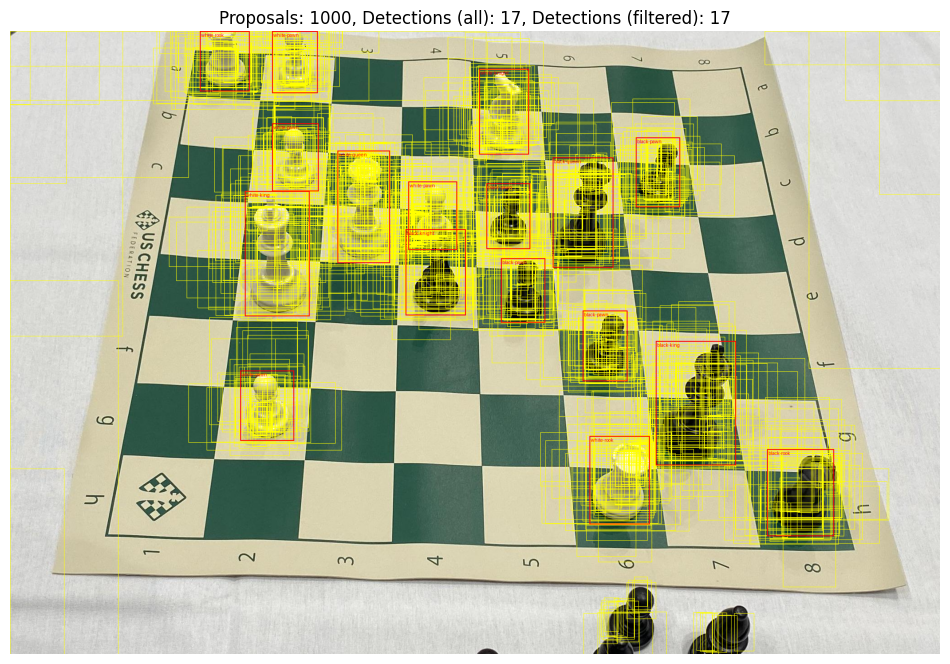

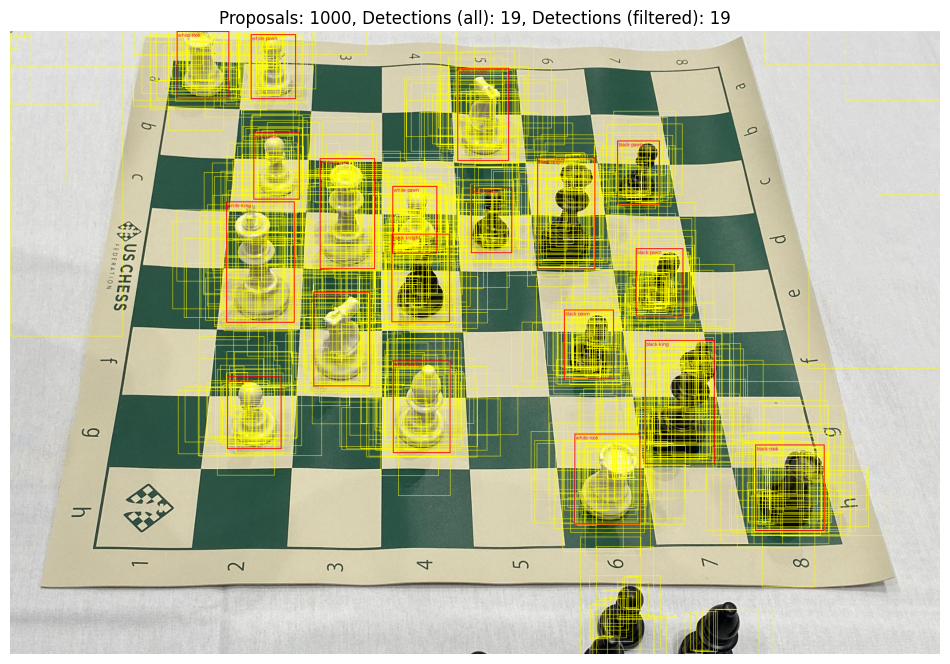

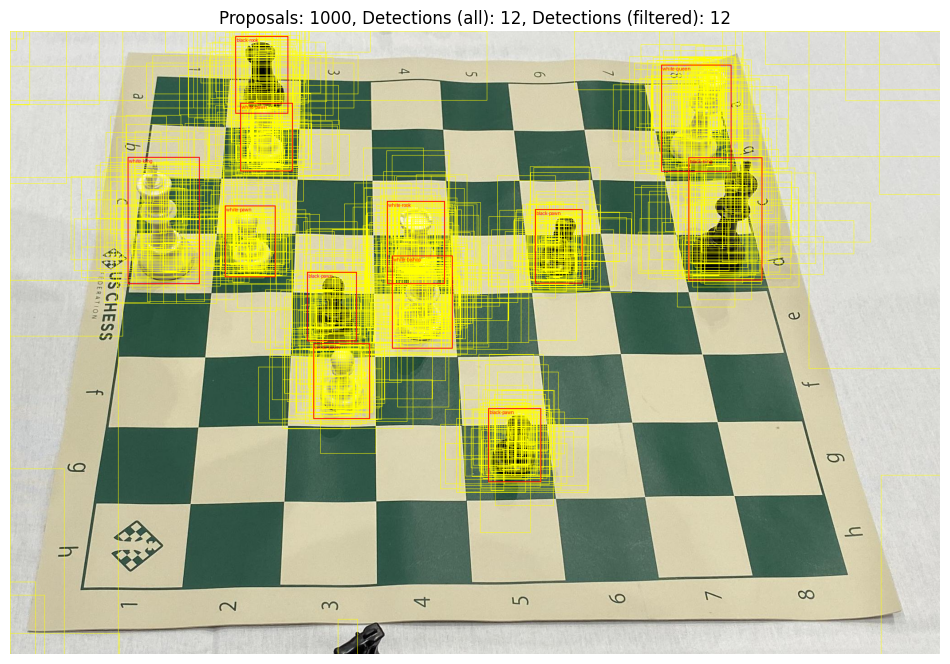

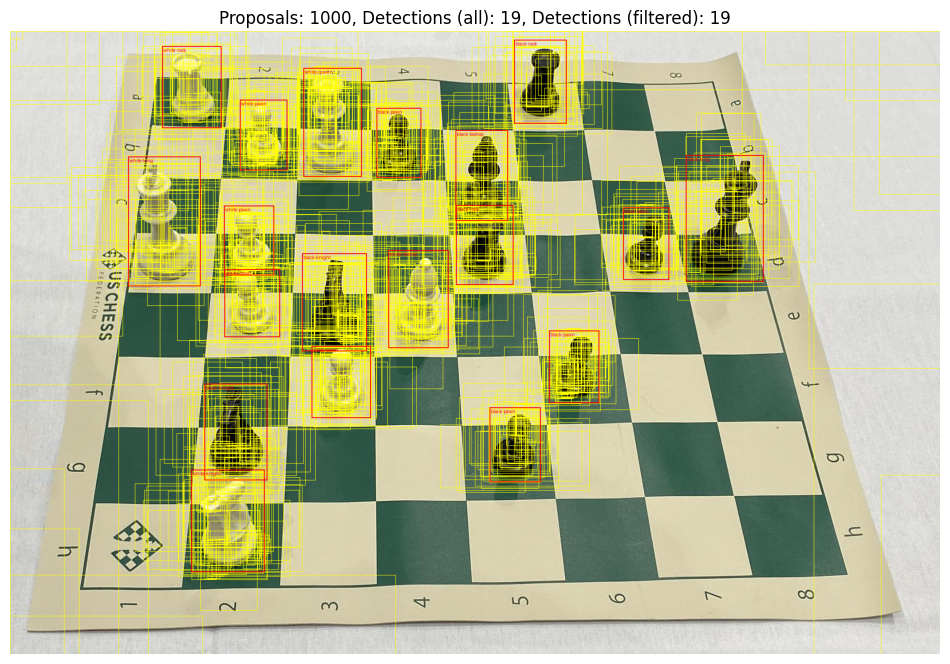

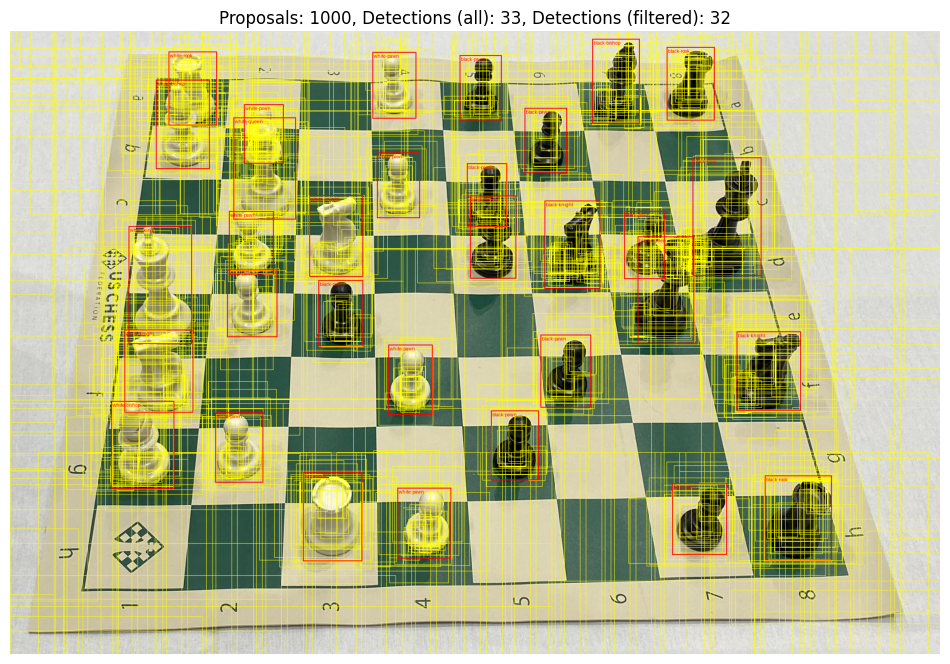

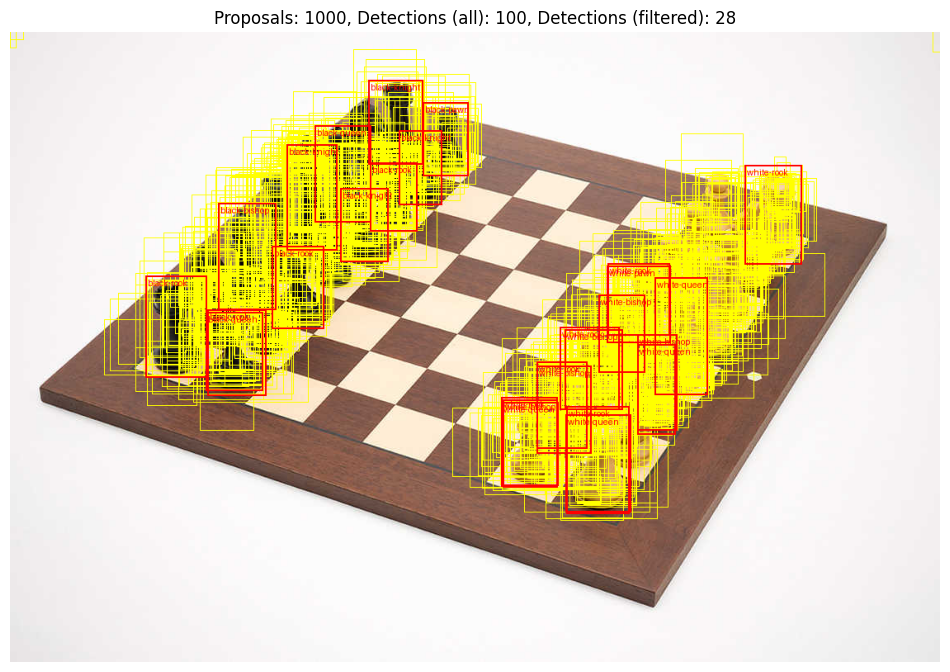

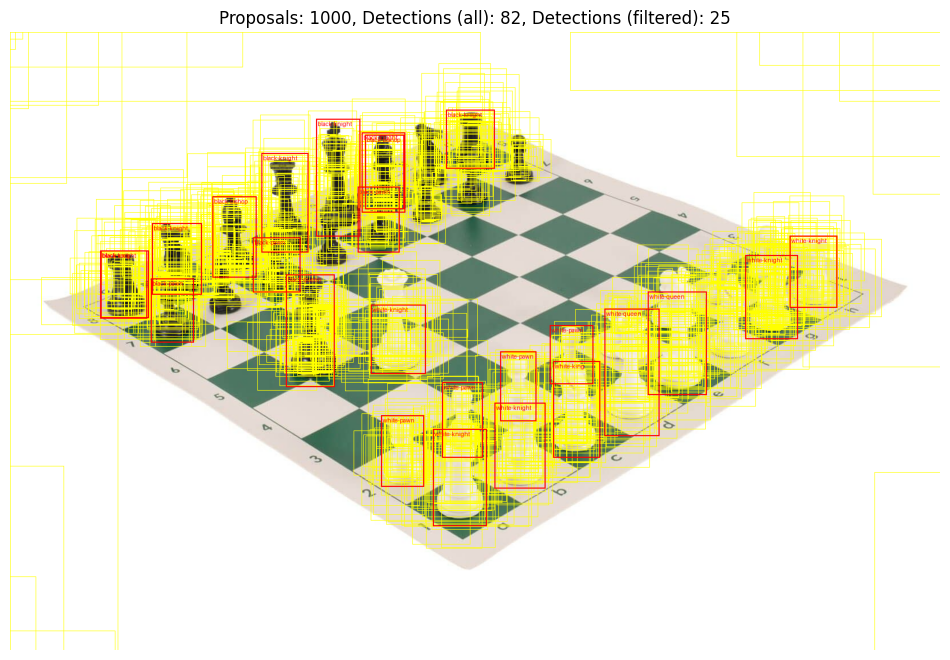

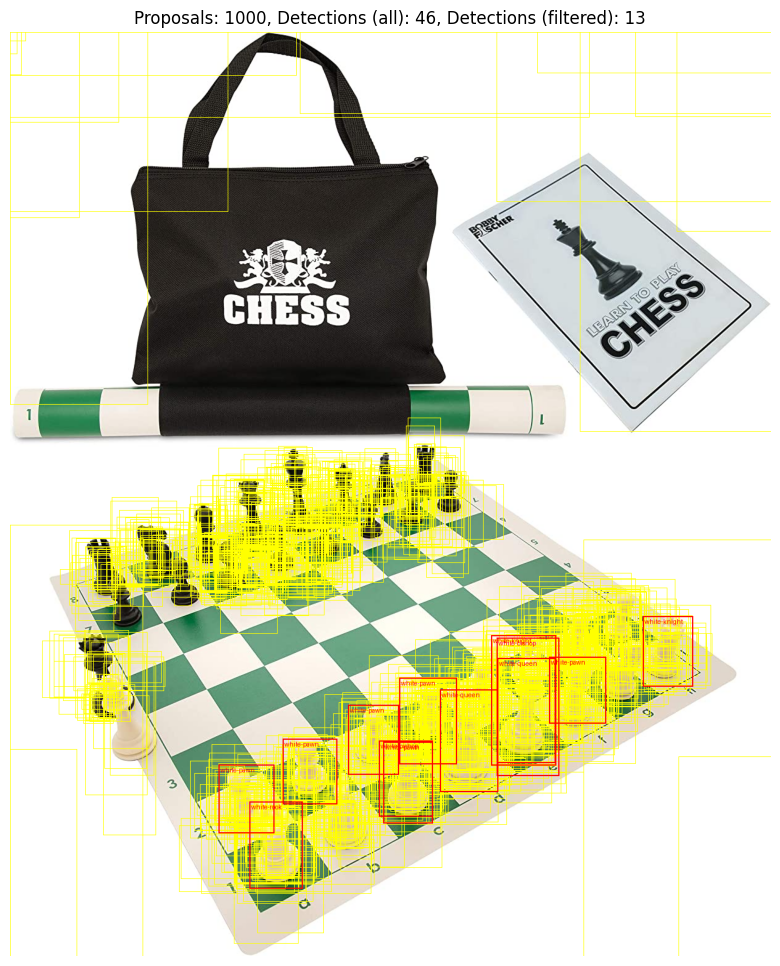

In [ ]:
for img_path in img_paths:
    img = read_image(img_path)
    batch = [preprocess(img).to(DEVICE)]
    model.eval()

    with torch.no_grad():
        proposals, predictions = extract_proposals_and_predictions(model, batch, DEVICE)
        visualize_proposals_and_predictions(batch, proposals, predictions, chess_val)

### Zadanie 2b

Zbadaj wpływ progu NMS _na etapie propozycji_ na jakość predykcji oraz czas ich uzyskania.
Jak w poprzednich zadaniach, postaraj się nie ograniczyć tylko do pokazania metryk, ale pokaż wizualizacje (propozycji i predykcji) dla **wybranych** przykładów.

In [ ]:
model.rpn.nms_thresh

0.7

In [ ]:
import time

def evaluate_with_rpn_nms_threshold(model, val_loader, device, nms_thresh):
    # Modify RPN NMS threshold
    model.rpn.nms_thresh = nms_thresh

    # Evaluate and measure time
    start_time = time.time()
    evaluate(model, val_loader, device=device)
    end_time = time.time()
    inference_time = end_time - start_time

    return inference_time


Evaluating with RPN NMS threshold: 0.05
Test:  [ 0/58]  eta: 0:00:43  model_time: 0.1519 (0.1519)  evaluator_time: 0.0073 (0.0073)  time: 0.7505  data: 0.5797  max mem: 1179
Test:  [57/58]  eta: 0:00:00  model_time: 0.1165 (0.1147)  evaluator_time: 0.0062 (0.0058)  time: 0.2363  data: 0.0793  max mem: 1179
Test: Total time: 0:00:12 (0.2226 s / it)
Averaged stats: model_time: 0.1165 (0.1147)  evaluator_time: 0.0062 (0.0058)
Accumulating evaluation results...
DONE (t=0.09s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.220
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.289
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.257
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.220
 Average Recall     (AR

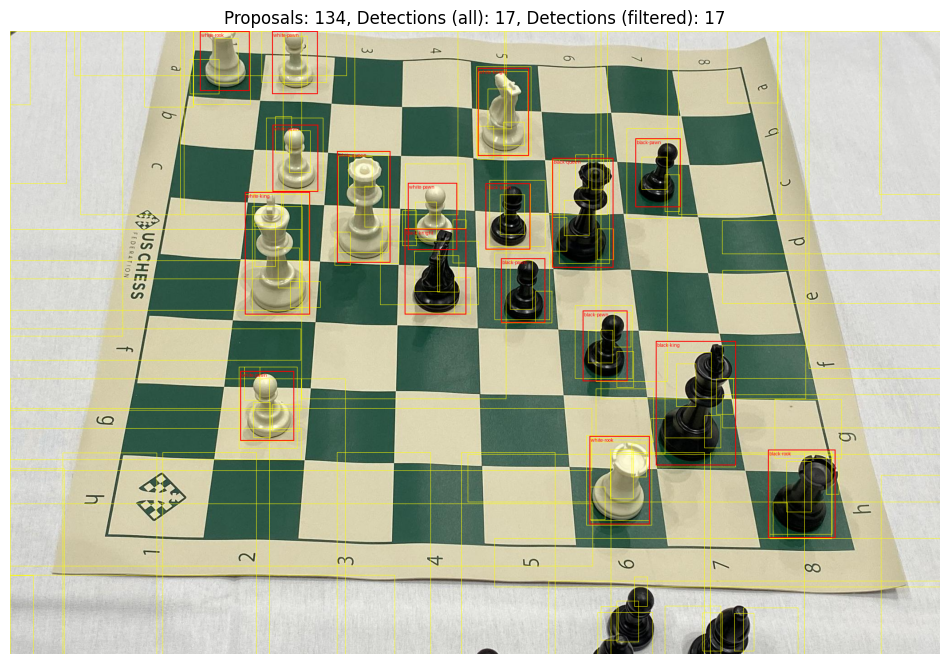

Evaluating with RPN NMS threshold: 0.1
Test:  [ 0/58]  eta: 0:00:46  model_time: 0.1107 (0.1107)  evaluator_time: 0.0060 (0.0060)  time: 0.8066  data: 0.6712  max mem: 1179
Test:  [57/58]  eta: 0:00:00  model_time: 0.1174 (0.1142)  evaluator_time: 0.0059 (0.0056)  time: 0.2374  data: 0.0796  max mem: 1179
Test: Total time: 0:00:13 (0.2248 s / it)
Averaged stats: model_time: 0.1174 (0.1142)  evaluator_time: 0.0059 (0.0056)
Accumulating evaluation results...
DONE (t=0.09s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.386
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.510
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.386
 Average Recall     (AR)

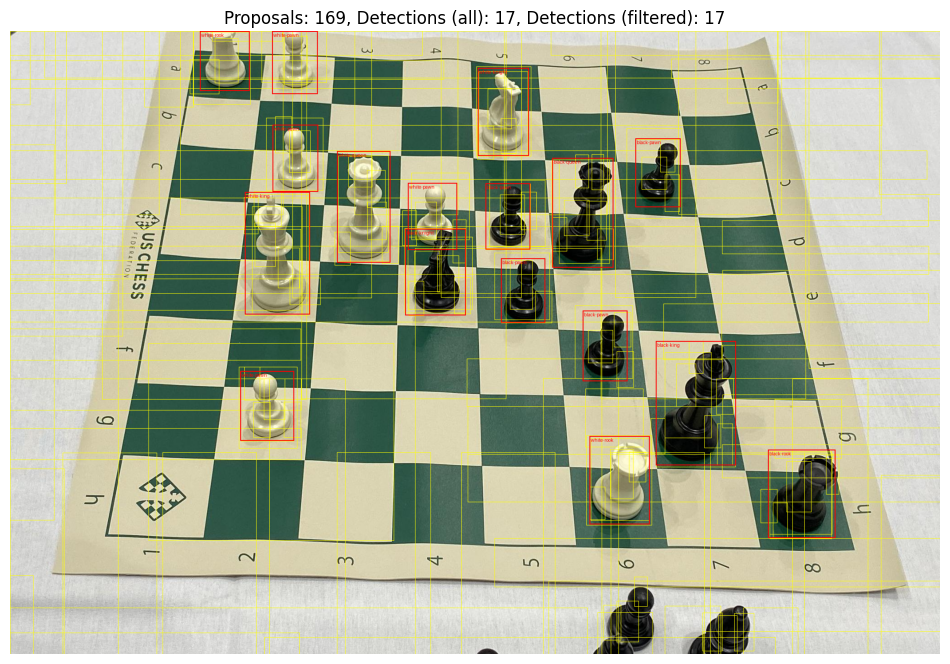

Evaluating with RPN NMS threshold: 0.2
Test:  [ 0/58]  eta: 0:00:45  model_time: 0.1105 (0.1105)  evaluator_time: 0.0071 (0.0071)  time: 0.7857  data: 0.6548  max mem: 1179
Test:  [57/58]  eta: 0:00:00  model_time: 0.1197 (0.1173)  evaluator_time: 0.0042 (0.0060)  time: 0.2418  data: 0.0803  max mem: 1179
Test: Total time: 0:00:13 (0.2284 s / it)
Averaged stats: model_time: 0.1197 (0.1173)  evaluator_time: 0.0042 (0.0060)
Accumulating evaluation results...
DONE (t=0.09s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.275
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.382
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.336
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.275
 Average Recall     (AR)

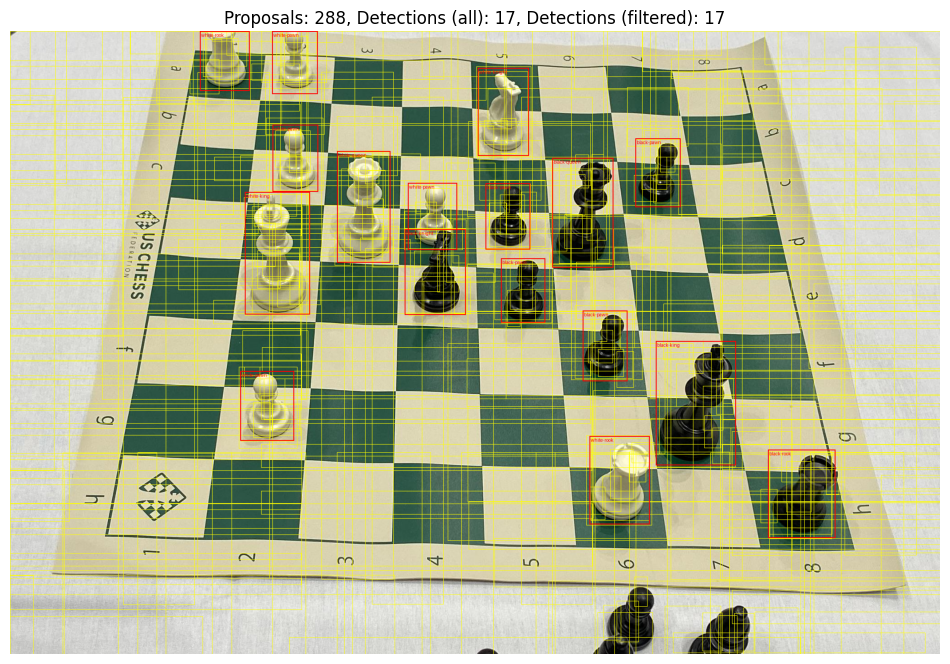

Evaluating with RPN NMS threshold: 0.5
Test:  [ 0/58]  eta: 0:00:49  model_time: 0.1163 (0.1163)  evaluator_time: 0.0062 (0.0062)  time: 0.8454  data: 0.7114  max mem: 1179
Test:  [57/58]  eta: 0:00:00  model_time: 0.1303 (0.1215)  evaluator_time: 0.0034 (0.0052)  time: 0.2413  data: 0.0791  max mem: 1179
Test: Total time: 0:00:13 (0.2269 s / it)
Averaged stats: model_time: 0.1303 (0.1215)  evaluator_time: 0.0034 (0.0052)
Accumulating evaluation results...
DONE (t=0.10s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.393
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.525
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.393
 Average Recall     (AR)

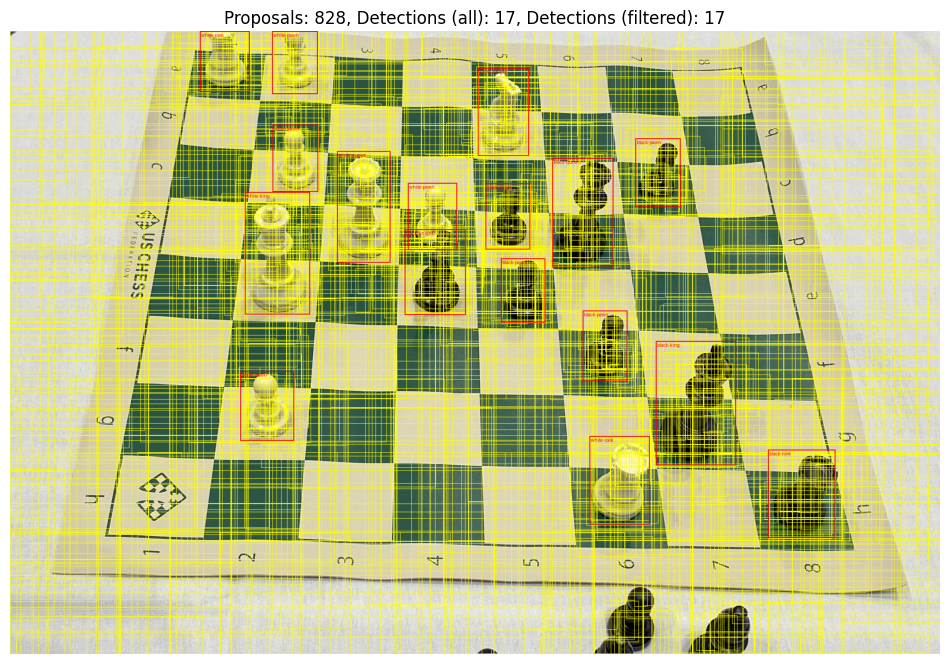

Evaluating with RPN NMS threshold: 0.7
Test:  [ 0/58]  eta: 0:00:49  model_time: 0.1105 (0.1105)  evaluator_time: 0.0076 (0.0076)  time: 0.8611  data: 0.7315  max mem: 1179
Test:  [57/58]  eta: 0:00:00  model_time: 0.1264 (0.1217)  evaluator_time: 0.0037 (0.0052)  time: 0.2691  data: 0.1014  max mem: 1179
Test: Total time: 0:00:13 (0.2409 s / it)
Averaged stats: model_time: 0.1264 (0.1217)  evaluator_time: 0.0037 (0.0052)
Accumulating evaluation results...
DONE (t=0.05s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.189
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.261
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.230
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.189
 Average Recall     (AR)

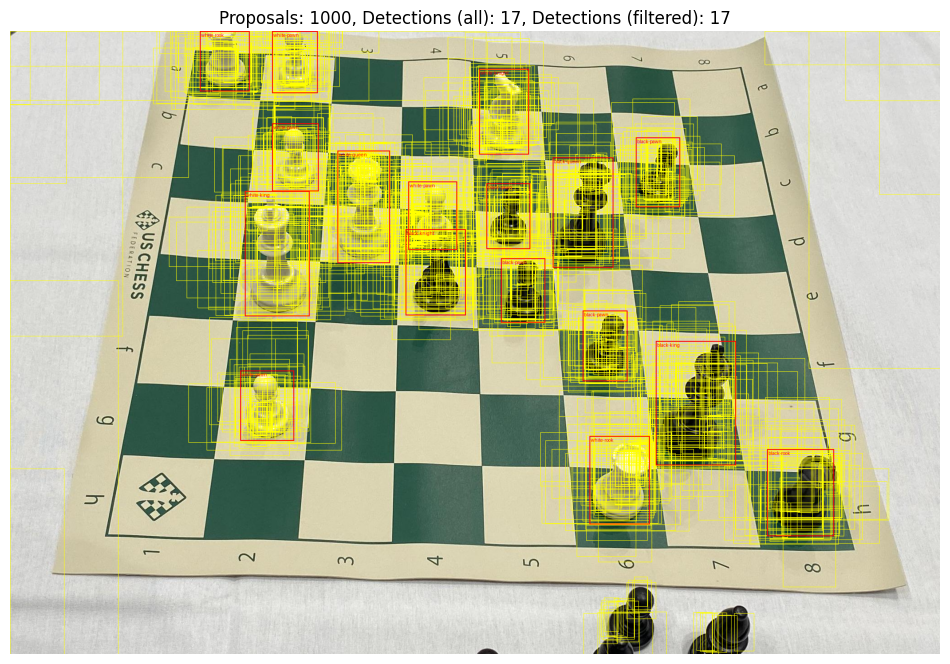

Evaluating with RPN NMS threshold: 0.9
Test:  [ 0/58]  eta: 0:00:52  model_time: 0.1199 (0.1199)  evaluator_time: 0.0062 (0.0062)  time: 0.8977  data: 0.7602  max mem: 1179
Test:  [57/58]  eta: 0:00:00  model_time: 0.1320 (0.1227)  evaluator_time: 0.0037 (0.0054)  time: 0.2621  data: 0.0928  max mem: 1179
Test: Total time: 0:00:13 (0.2380 s / it)
Averaged stats: model_time: 0.1320 (0.1227)  evaluator_time: 0.0037 (0.0054)
Accumulating evaluation results...
DONE (t=0.05s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.316
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.414
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.383
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.316
 Average Recall     (AR)

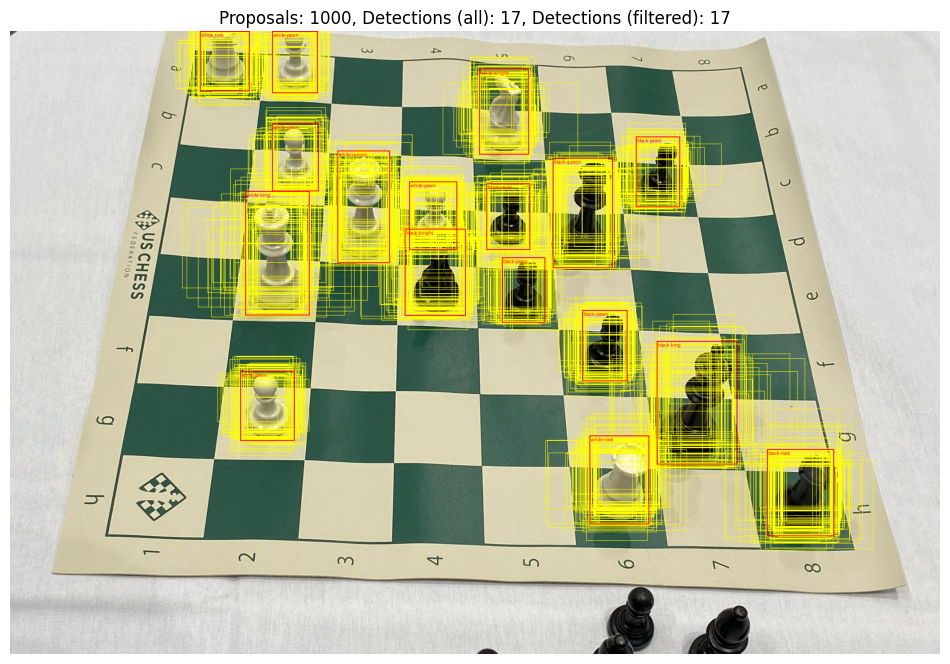

Evaluating with RPN NMS threshold: 0.95
Test:  [ 0/58]  eta: 0:00:52  model_time: 0.1188 (0.1188)  evaluator_time: 0.0062 (0.0062)  time: 0.8976  data: 0.7612  max mem: 1179
Test:  [57/58]  eta: 0:00:00  model_time: 0.1299 (0.1269)  evaluator_time: 0.0034 (0.0052)  time: 0.2571  data: 0.0873  max mem: 1179
Test: Total time: 0:00:13 (0.2387 s / it)
Averaged stats: model_time: 0.1299 (0.1269)  evaluator_time: 0.0034 (0.0052)
Accumulating evaluation results...
DONE (t=0.04s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.065
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.073
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.065
 Average Recall     (AR

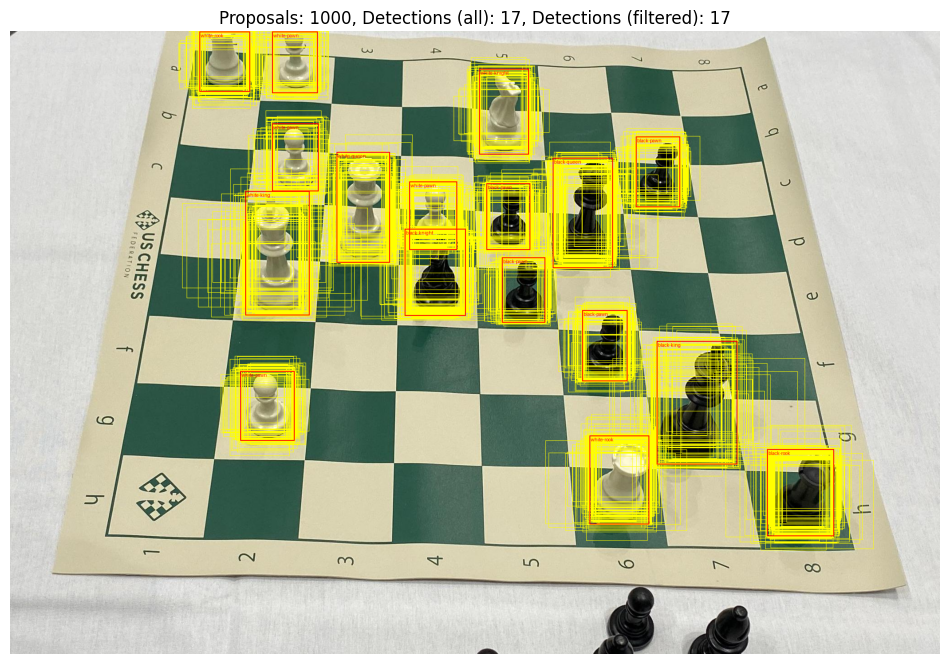

In [ ]:

original_nms_thresh = model.rpn.nms_thresh

nms_thresholds = [0.05, 0.1, 0.2, 0.5, 0.7, 0.9, 0.95]

# Evaluate for each threshold
for nms_thresh in nms_thresholds:
    print(f"Evaluating with RPN NMS threshold: {nms_thresh}")
    inference_time = evaluate_with_rpn_nms_threshold(model, val_loader, DEVICE, nms_thresh)
    print(f"Inference time: {inference_time:.2f} seconds")

    # Visualize for a selected image
    # Example: Visualize for the first image in img_paths
    img = read_image(img_paths[0])
    batch = [preprocess(img).to(DEVICE)]

    with torch.no_grad():
        start_time = time.time()
        proposals, predictions = extract_proposals_and_predictions(model, batch, DEVICE)
        end_time = time.time()
        inference_time = end_time - start_time
        print(f"Inference time for visualization: {inference_time:.2f} seconds")
        visualize_proposals_and_predictions(batch, proposals, predictions, chess_val)  # Update the visualization function as provided previously


model.rpn.nms_thresh = original_nms_thresh

RPN NMS (Region Proporsal Network - Non-Maximum Suppression)
Mimo zmian w wartościach progu nie widać różnicy w czasie przetwarzania (minimlna w podczas evaluacji DONE (t=0.04s), DONE (t=0.10s)). natomiast widać w wynikiach.


*   Niższy próg: Mniej propozycji → mniejsze ryzyko duplikatów → mniejsza dokładność w przypadku bliskich obiektów.
*   Wyższy próg: Więcej propozycji → większa szansa wykrycia bliskich obiektów → dłuższy czas przetwarzania.



## Zmiana limintu liczby propozycji

In [ ]:
DEVICE = 'cuda:0'
model = model.to(DEVICE)
next(model.parameters()).device

device(type='cuda', index=0)

In [ ]:
model.rpn._pre_nms_top_n['testing'] = 10_000
model.rpn._post_nms_top_n['testing'] = 10_000


Evaluating with RPN NMS threshold: 0.05
Test:  [ 0/58]  eta: 0:02:50  model_time: 2.3344 (2.3344)  evaluator_time: 0.0036 (0.0036)  time: 2.9473  data: 0.5972  max mem: 1063
Test:  [57/58]  eta: 0:00:00  model_time: 0.1329 (0.1869)  evaluator_time: 0.0018 (0.0053)  time: 0.2065  data: 0.0453  max mem: 1071
Test: Total time: 0:00:16 (0.2897 s / it)
Averaged stats: model_time: 0.1329 (0.1869)  evaluator_time: 0.0018 (0.0053)
Accumulating evaluation results...
DONE (t=0.05s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.246
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.296
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.246
 Average Recall     (AR

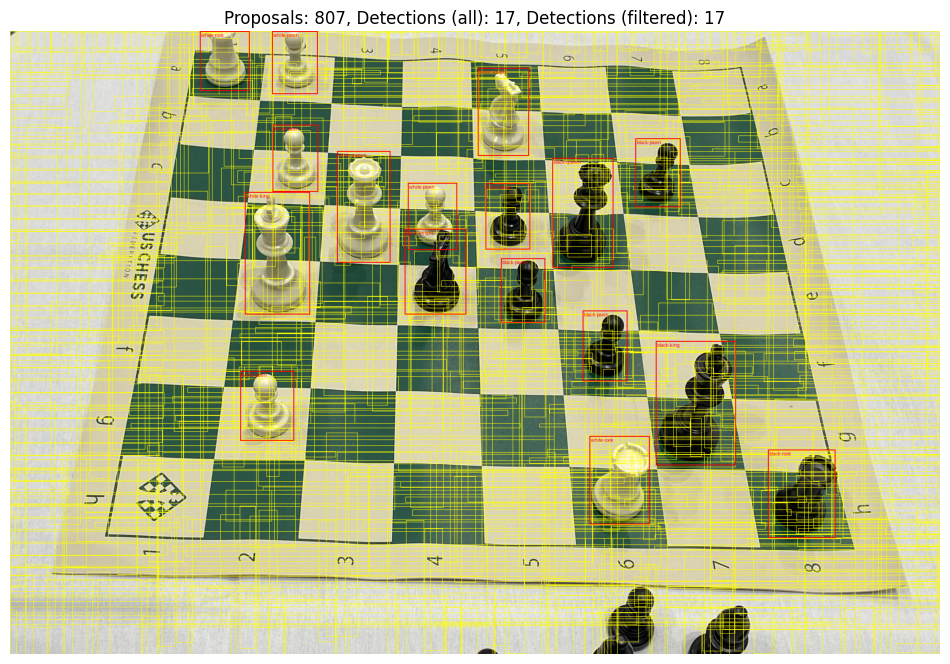

Evaluating with RPN NMS threshold: 0.1
Test:  [ 0/58]  eta: 0:00:51  model_time: 0.1370 (0.1370)  evaluator_time: 0.0061 (0.0061)  time: 0.8904  data: 0.7352  max mem: 1103
Test:  [57/58]  eta: 0:00:00  model_time: 0.1361 (0.1551)  evaluator_time: 0.0017 (0.0050)  time: 0.1992  data: 0.0306  max mem: 1103
Test: Total time: 0:00:14 (0.2560 s / it)
Averaged stats: model_time: 0.1361 (0.1551)  evaluator_time: 0.0017 (0.0050)
Accumulating evaluation results...
DONE (t=0.05s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.177
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.240
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.212
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.177
 Average Recall     (AR)

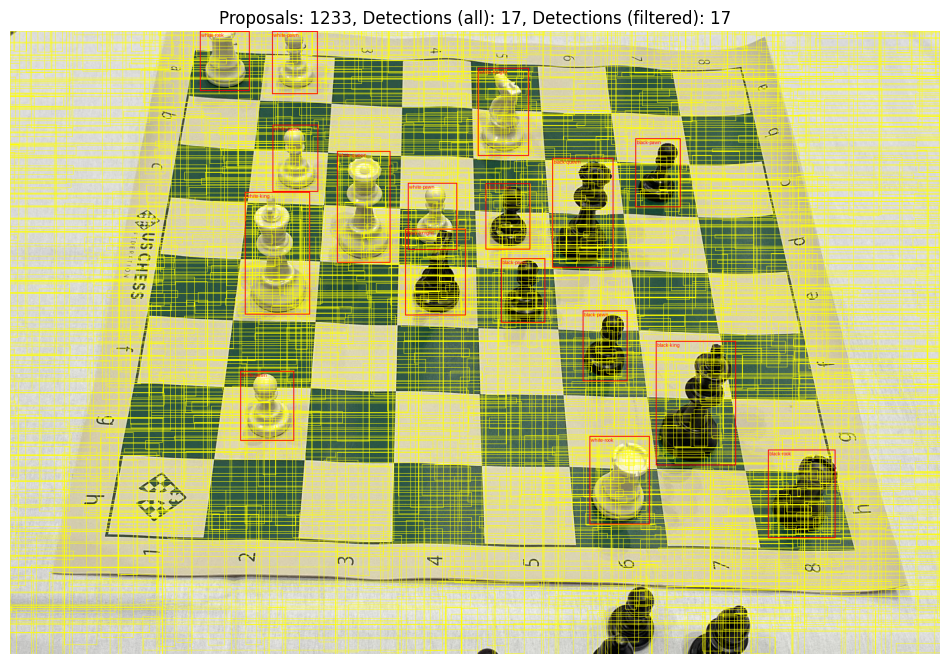

Evaluating with RPN NMS threshold: 0.2
Test:  [ 0/58]  eta: 0:01:18  model_time: 0.2575 (0.2575)  evaluator_time: 0.0127 (0.0127)  time: 1.3458  data: 1.0647  max mem: 1103
Test:  [57/58]  eta: 0:00:00  model_time: 0.1504 (0.1638)  evaluator_time: 0.0021 (0.0051)  time: 0.2064  data: 0.0247  max mem: 1103
Test: Total time: 0:00:15 (0.2616 s / it)
Averaged stats: model_time: 0.1504 (0.1638)  evaluator_time: 0.0021 (0.0051)
Accumulating evaluation results...
DONE (t=0.08s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.178
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.243
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.210
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.178
 Average Recall     (AR)

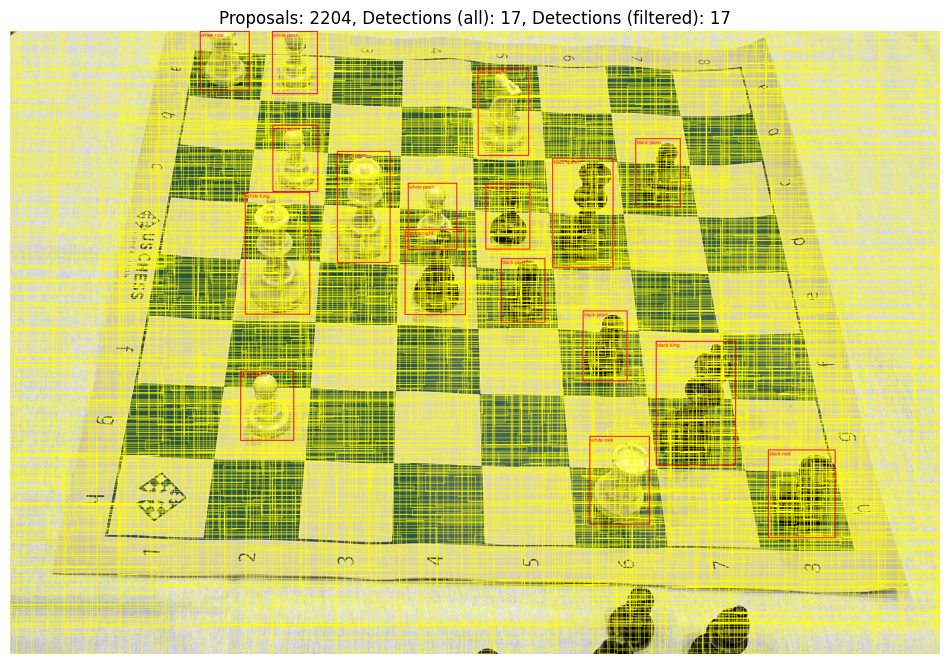

Evaluating with RPN NMS threshold: 0.5
Test:  [ 0/58]  eta: 0:01:24  model_time: 0.3414 (0.3414)  evaluator_time: 0.0264 (0.0264)  time: 1.4541  data: 1.0613  max mem: 1584
Test:  [57/58]  eta: 0:00:00  model_time: 0.2424 (0.2459)  evaluator_time: 0.0019 (0.0044)  time: 0.3152  data: 0.0332  max mem: 1596
Test: Total time: 0:00:18 (0.3200 s / it)
Averaged stats: model_time: 0.2424 (0.2459)  evaluator_time: 0.0019 (0.0044)
Accumulating evaluation results...
DONE (t=0.06s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.370
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.489
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.446
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.370
 Average Recall     (AR)

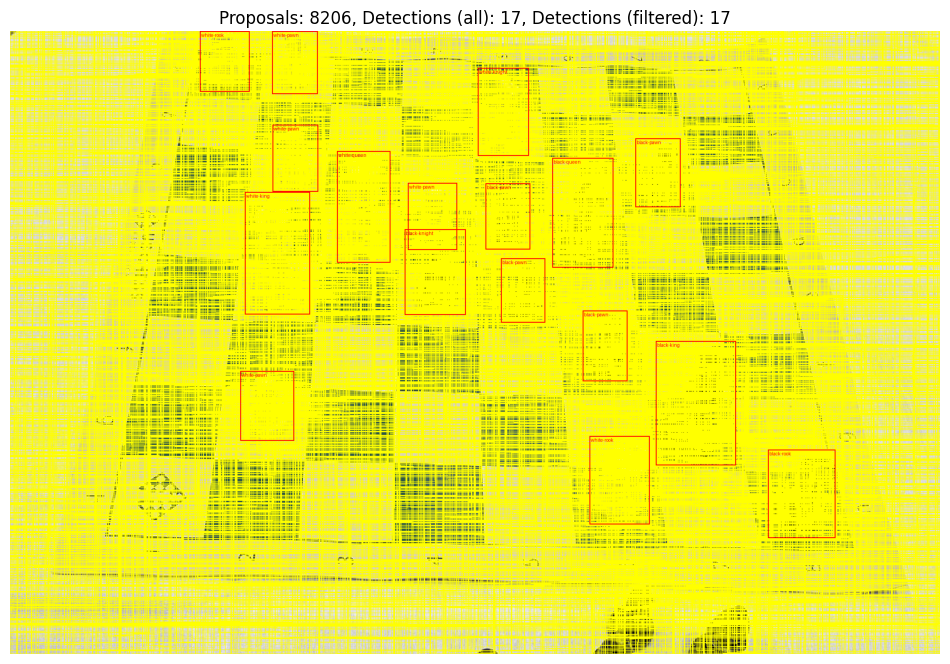

Evaluating with RPN NMS threshold: 0.7
Test:  [ 0/58]  eta: 0:01:08  model_time: 0.3422 (0.3422)  evaluator_time: 0.0069 (0.0069)  time: 1.1849  data: 0.8245  max mem: 1762
Test:  [57/58]  eta: 0:00:00  model_time: 0.2795 (0.2906)  evaluator_time: 0.0016 (0.0040)  time: 0.3146  data: 0.0170  max mem: 1762
Test: Total time: 0:00:20 (0.3585 s / it)
Averaged stats: model_time: 0.2795 (0.2906)  evaluator_time: 0.0016 (0.0040)
Accumulating evaluation results...
DONE (t=0.05s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.251
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.302
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.251
 Average Recall     (AR)

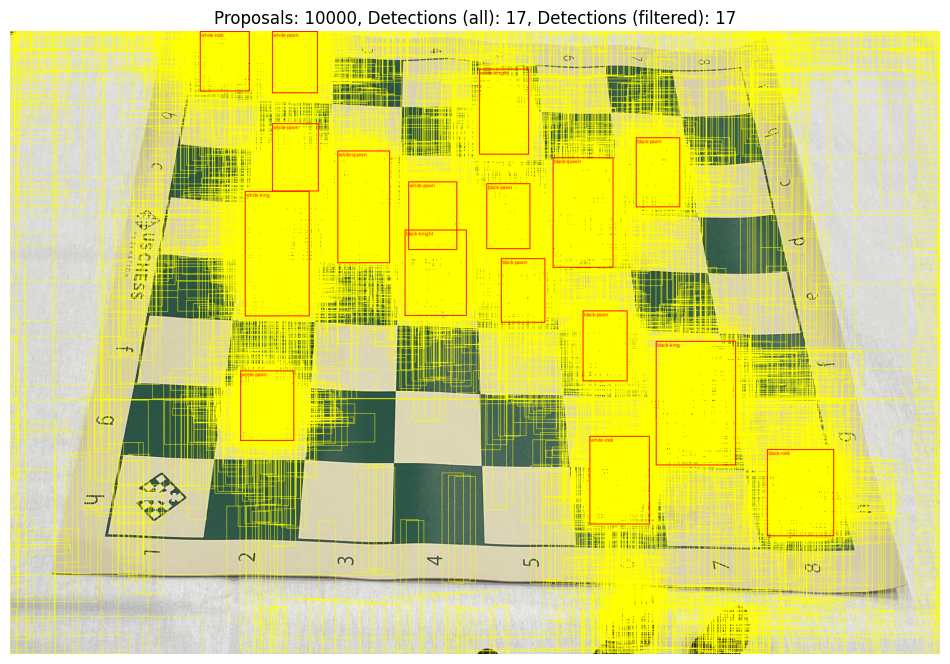

Evaluating with RPN NMS threshold: 0.9
Test:  [ 0/58]  eta: 0:01:21  model_time: 0.3620 (0.3620)  evaluator_time: 0.0185 (0.0185)  time: 1.3989  data: 0.9938  max mem: 1762
Test:  [57/58]  eta: 0:00:00  model_time: 0.2964 (0.3013)  evaluator_time: 0.0016 (0.0041)  time: 0.3679  data: 0.0339  max mem: 1763
Test: Total time: 0:00:21 (0.3727 s / it)
Averaged stats: model_time: 0.2964 (0.3013)  evaluator_time: 0.0016 (0.0041)
Accumulating evaluation results...
DONE (t=0.05s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.283
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.380
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.335
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.283
 Average Recall     (AR)

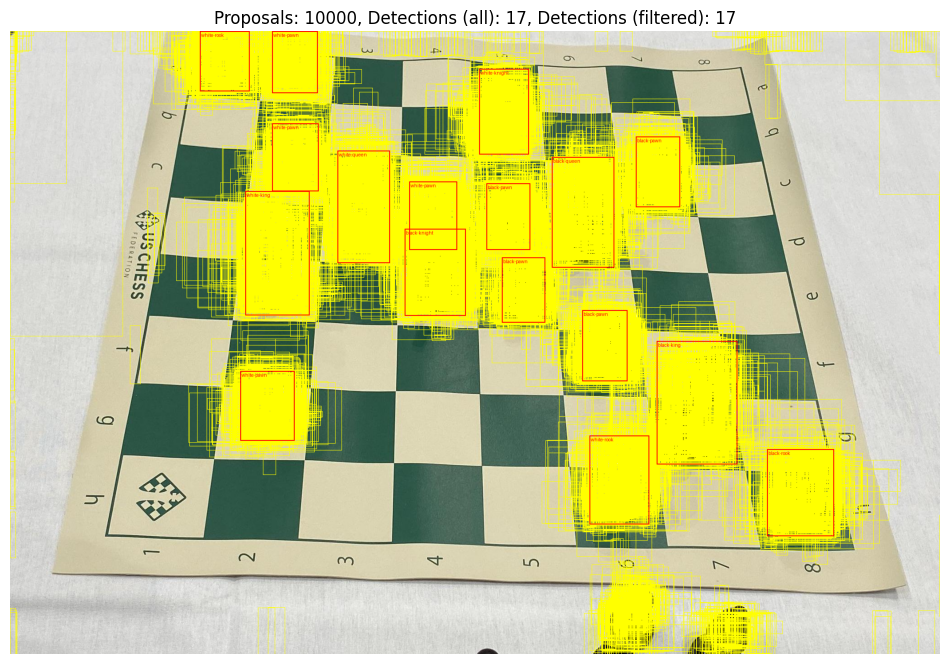

Evaluating with RPN NMS threshold: 0.95
Test:  [ 0/58]  eta: 0:01:00  model_time: 0.3198 (0.3198)  evaluator_time: 0.0083 (0.0083)  time: 1.0493  data: 0.7098  max mem: 1763
Test:  [57/58]  eta: 0:00:00  model_time: 0.2878 (0.3033)  evaluator_time: 0.0018 (0.0041)  time: 0.3403  data: 0.0239  max mem: 1764
Test: Total time: 0:00:21 (0.3642 s / it)
Averaged stats: model_time: 0.2878 (0.3033)  evaluator_time: 0.0018 (0.0041)
Accumulating evaluation results...
DONE (t=0.09s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.153
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.209
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.175
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.153
 Average Recall     (AR

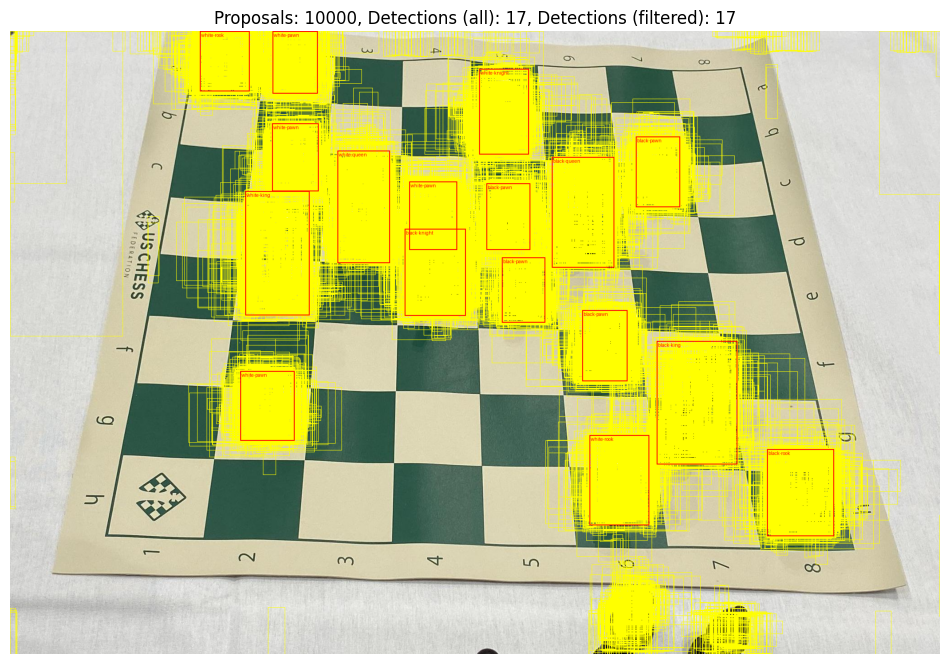

In [ ]:
original_nms_thresh = model.rpn.nms_thresh
nms_thresholds = [0.05, 0.1, 0.2, 0.5, 0.7, 0.9, 0.95]

# Evaluate for each threshold
for nms_thresh in nms_thresholds:
    print(f"Evaluating with RPN NMS threshold: {nms_thresh}")
    inference_time = evaluate_with_rpn_nms_threshold(model, val_loader, DEVICE, nms_thresh)
    print(f"Inference time: {inference_time:.2f} seconds")

    # Visualize for a selected image
    # Example: Visualize for the first image in img_paths
    img = read_image(img_paths[0])
    batch = [preprocess(img).to(DEVICE)]

    with torch.no_grad():
        start_time = time.time()
        proposals, predictions = extract_proposals_and_predictions(model, batch, DEVICE)
        end_time = time.time()
        inference_time = end_time - start_time
        print(f"Inference time for visualization: {inference_time:.2f} seconds")
        visualize_proposals_and_predictions(batch, proposals, predictions, chess_val)  # Update the visualization function as provided previously


model.rpn.nms_thresh = original_nms_thresh

Po wprowadzonych zmianach czas obliczeń znacznie się wydłużył z powodu zwiększenia liczby porównań - algorytm NMS będzie przetwarzał więcej propozycji.

Może być przydatne o gęsto rozmieszczonych obiektach o niskim scorze.

Szczególnie ciekawym przypdakiem jest NMS threshold - 0.5 oraz ponad 8k propozycji, które są rozmieszczone praktycznie po całym obszarze zdjęcia.